# Applied Data Science Capstone Project: The relationship between Foursquare activities clusters, socio-economic factors and COVID-19 health data for US counties

### by Alexey Usoltsev
05/05/2020

In [1]:
%pip install tabulate
%pip install lxml
%pip install beautifulsoup4

Note: you may need to restart the kernel to use updated packages.
     |████████████████████████████████| 5.8MB 503kB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.
     |████████████████████████████████| 112kB 7.9MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [2]:
import pandas as pd
import numpy as np
import requests
from bs4 import BeautifulSoup
from tabulate import tabulate

# 1. Download coronavirus data by county.

In [3]:
#Download coronovirus data
counties_corona_cases_df = pd.read_csv("https://usafactsstatic.blob.core.windows.net/public/data/covid-19/covid_confirmed_usafacts.csv") #cases data 
counties_corona_deaths_df = pd.read_csv("https://usafactsstatic.blob.core.windows.net/public/data/covid-19/covid_deaths_usafacts.csv") #deaths data
counties_pop_df = pd.read_csv("https://usafactsstatic.blob.core.windows.net/public/data/covid-19/covid_county_population_usafacts.csv") #population size data
counties_density_df = pd.read_csv("CountyPopulationDensity.csv") #Population Density Data

In [4]:
counties_corona_cases_df['countyFIPS']=counties_corona_cases_df['countyFIPS'].astype(str)
counties_corona_cases_df['stateFIPS']=counties_corona_cases_df['stateFIPS'].astype(str)
counties_corona_cases_df['totalCases'] = counties_corona_cases_df.iloc[:,-1] # last column is a cumulative total number of cases #Data for 17.04 not loaded yet!!!
counties_corona_cases_df = counties_corona_cases_df[counties_corona_cases_df['County Name'] != 'Statewide Unallocated']
counties_corona_cases_df.set_index('countyFIPS', drop=False, inplace=True)

In [5]:
counties_corona_cases_df.head()

,countyFIPS,County Name,State,stateFIPS,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,4/27/20,4/28/20,4/29/20,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,totalCases
countyFIPS,,,,,,,,,,,,,,,,,,,,,
1001,1001,Autauga County,AL,1,0,0,0,0,0,0,...,39,40,42,42,42,45,48,53,53,53
1003,1003,Baldwin County,AL,1,0,0,0,0,0,0,...,168,171,173,174,175,181,187,188,189,189
1005,1005,Barbour County,AL,1,0,0,0,0,0,0,...,35,37,37,39,42,43,45,45,47,47
1007,1007,Bibb County,AL,1,0,0,0,0,0,0,...,42,42,42,42,42,42,42,42,43,43
1009,1009,Blount County,AL,1,0,0,0,0,0,0,...,34,34,36,37,39,40,40,40,40,40


## Calculate rates for Cases time series

In [6]:
dates = pd.date_range(start = counties_corona_cases_df.columns[4], end=counties_corona_cases_df.columns[-2], freq='D').strftime("%-m/%-d/%y").tolist()

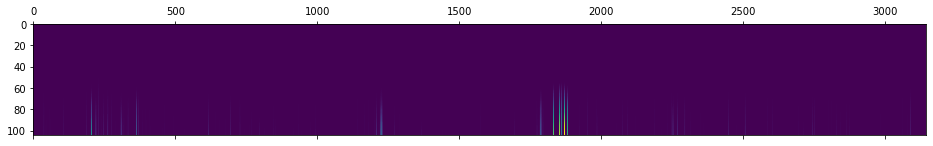

In [7]:
from matplotlib import pyplot
ts_cases=counties_corona_cases_df[dates].transpose()
ts_cases.set_index(pd.to_datetime(ts_cases.index), inplace=True)
pyplot.matshow(ts_cases, interpolation=None, aspect='auto')
pyplot.show()

In [8]:
pd.set_option('use_inf_as_na', True) #turn inf to NaN
ts_cases_rate = ts_cases.pct_change()
rate_cases = ts_cases_rate.mean()
rate_cases = rate_cases.to_frame(name = 'RateCases')
rate_cases.head()

,RateCases
countyFIPS,
1001,0.140573
1003,0.120491
1005,0.153062
1007,0.098129
1009,0.116223


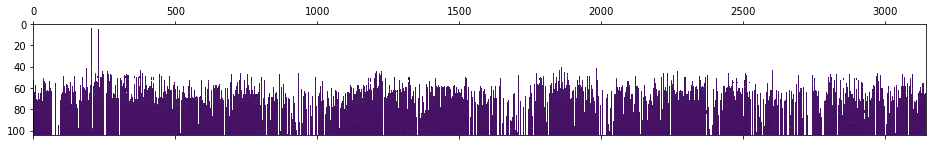

In [9]:
pyplot.matshow(ts_cases_rate, interpolation=None, aspect='auto')
pyplot.show()

In [10]:
counties_corona_cases_df = counties_corona_cases_df.merge(rate_cases, left_index=True, right_index=True)
counties_corona_cases_df.head()

,countyFIPS,County Name,State,stateFIPS,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,4/28/20,4/29/20,4/30/20,5/1/20,5/2/20,5/3/20,5/4/20,5/5/20,totalCases,RateCases
countyFIPS,,,,,,,,,,,,,,,,,,,,,
1001,1001,Autauga County,AL,1,0,0,0,0,0,0,...,40,42,42,42,45,48,53,53,53,0.140573
1003,1003,Baldwin County,AL,1,0,0,0,0,0,0,...,171,173,174,175,181,187,188,189,189,0.120491
1005,1005,Barbour County,AL,1,0,0,0,0,0,0,...,37,37,39,42,43,45,45,47,47,0.153062
1007,1007,Bibb County,AL,1,0,0,0,0,0,0,...,42,42,42,42,42,42,42,43,43,0.098129
1009,1009,Blount County,AL,1,0,0,0,0,0,0,...,34,36,37,39,40,40,40,40,40,0.116223


# Download deaths data

In [11]:
counties_corona_deaths_df['countyFIPS']=counties_corona_deaths_df['countyFIPS'].astype(str)
counties_corona_deaths_df['stateFIPS']=counties_corona_deaths_df['stateFIPS'].astype(str)
counties_corona_deaths_df['totalDeaths'] = counties_corona_deaths_df.iloc[:,-1] # last column is a cumulative total number of deaths
counties_corona_deaths_df = counties_corona_deaths_df[counties_corona_deaths_df['County Name'] != 'Statewide Unallocated']
counties_corona_deaths_df.set_index('countyFIPS', drop=False, inplace=True)

In [12]:
counties_pop_df['countyFIPS']=counties_pop_df['countyFIPS'].astype(str)
counties_pop_df = counties_pop_df[counties_pop_df['County Name'] != 'Statewide Unallocated']
counties_pop_df.set_index('countyFIPS', drop=False, inplace=True)

In [13]:
counties_density_df['countyFIPS'] = counties_density_df['GCT_STUB.target-geo-id2'].astype(str)
counties_density_df['Density'] = counties_density_df['Density per square mile of land area']
counties_density_df.set_index('countyFIPS', drop=False, inplace=True)

In [14]:
counties_corona_df = counties_corona_cases_df[['countyFIPS','County Name','State','stateFIPS', 'totalCases','RateCases']].merge(
                              counties_corona_deaths_df[['totalDeaths']], left_index=True, right_index=True)

In [15]:
counties_df = counties_corona_df.merge(counties_pop_df[['population']], right_index=True, left_index=True)
counties_df = counties_df.merge(counties_density_df[['Density']], right_index=True, left_index=True)

In [16]:
counties_df['cases/1TH pop']=counties_df['totalCases']/counties_df['population']*1000
counties_df['Mortality Rate'] = counties_df['totalDeaths']*100/counties_df['totalCases']

In [17]:
counties_coord_df = pd.read_csv("counties_coord_df.csv") #county coordinates data form another dataset (with FIPS)
counties_coord_df['FIPS'] = counties_coord_df['FIPS'].astype(str)
counties_coord_df.set_index('FIPS', drop=False, inplace=True)

In [18]:
counties_df = counties_df.merge(counties_coord_df[['Centroid Latitude','Centroid Longitude']], left_index=True, right_index=True)
counties_df.rename(
    columns={
        'Centroid Latitude': 'Latitude',
        'Centroid Longitude': 'Longitude'
    },
    inplace=True
)
counties_df.dropna(axis=0, inplace=True)
print(counties_df.shape)

(2854, 13)


In [19]:
counties_health_df = pd.read_csv("2020 County Health Ranking.csv", encoding='utf-8', sep = ";") #health ranking conty level data
counties_health_df.rename(
    columns={
        'FIPS': 'countyFIPS',
        'Other Primary Care Provider RatioToOne': 'PCP Ratio'
    },
    inplace=True
)

cols_to_float = ['Life Expectancy', '% 65 and over', '% Rural', '% Asian', '% Hispanic']
for col in cols_to_float:
    counties_health_df[col]=counties_health_df[col].str.replace(',','.').astype('float')
    
counties_health_df.dropna(axis=0, inplace=True)
counties_health_df['countyFIPS']=counties_health_df['countyFIPS'].astype(str)
counties_health_df.drop(['State'], axis = 1, inplace = True)
counties_health_df.drop(['County'], axis = 1, inplace = True)

counties_health_df.set_index('countyFIPS', drop=True, inplace=True)

In [20]:
counties_df = counties_df.merge(counties_health_df, right_index=True, left_index=True)

In [21]:
counties_df['County Name/FIPS'] = counties_df['County Name'] + counties_df['countyFIPS']
counties_df.shape

(2813, 24)

In [22]:
# select counties with non-zero Mortality rate
counties_df = counties_df[counties_df['Mortality Rate'] != 0]
counties_df.shape

(1521, 24)

In [23]:
pd.options.display.max_columns = None
counties_df.head()

,countyFIPS,County Name,State,stateFIPS,totalCases,RateCases,totalDeaths,population,Density,cases/1TH pop,Mortality Rate,Latitude,Longitude,Life Expectancy,Age-Adjusted Death Rate,% Frequent Physical Distress,% Uninsured,PCP Ratio,Median Household Income,% 65 and over,% Asian,% Hispanic,% Rural,County Name/FIPS
1001,1001,Autauga County,AL,1,53,0.140573,3,55869,91.8,0.948648,5.660377,32.534922,-86.642743,76.9,418.0,14,11.0,2527.0,59338.0,15.6,1.2,3.0,42.0,Autauga County1001
1003,1003,Baldwin County,AL,1,189,0.120491,5,223234,114.6,0.846645,2.645503,30.727484,-87.722570,78.5,353.0,12,14.0,1787.0,57588.0,20.4,1.2,4.6,42.3,Baldwin County1003
1005,1005,Barbour County,AL,1,47,0.153062,1,24686,31.0,1.903913,2.127660,31.869579,-85.393212,75.3,497.0,17,16.0,1914.0,34382.0,19.4,0.5,4.3,67.8,Barbour County1005
1013,1013,Butler County,AL,1,120,0.142126,2,19448,27.0,6.170300,1.666667,31.752441,-86.680292,72.9,609.0,17,15.0,1406.0,37365.0,20.3,1.3,1.5,71.2,Butler County1013
1015,1015,Calhoun County,AL,1,114,0.133572,3,113605,195.7,1.003477,2.631579,33.771419,-85.826050,73.0,575.0,15,15.0,1786.0,45400.0,17.7,1.0,3.9,33.7,Calhoun County1015


In [24]:
counties_df[counties_df['State']=='ND']

,countyFIPS,County Name,State,stateFIPS,totalCases,RateCases,totalDeaths,population,Density,cases/1TH pop,Mortality Rate,Latitude,Longitude,Life Expectancy,Age-Adjusted Death Rate,% Frequent Physical Distress,% Uninsured,PCP Ratio,Median Household Income,% 65 and over,% Asian,% Hispanic,% Rural,County Name/FIPS
38017,38017,Cass County,ND,38,643,0.168504,2,181923,84.9,3.534462,0.311042,46.932975,-97.248047,81.1,280.0,9,8.0,532.0,63885.0,12.0,3.6,2.8,10.4,Cass County38017
38029,38029,Emmons County,ND,38,1,0.000000,1,3241,2.4,0.308547,100.000000,46.285042,-100.238773,80.8,312.0,9,11.0,659.0,47976.0,27.9,1.0,1.1,100.0,Emmons County38029
38049,38049,McHenry County,ND,38,1,0.000000,1,5745,2.9,0.174064,100.000000,48.234568,-100.636276,78.5,333.0,8,9.0,1454.0,54795.0,20.4,0.3,2.1,100.0,McHenry County38049
38059,38059,Morton County,ND,38,35,0.073229,2,31364,14.3,1.115929,5.714286,46.716054,-101.281182,78.5,344.0,8,8.0,3887.0,68043.0,16.7,0.5,3.7,31.9,Morton County38059
38089,38089,Stark County,ND,38,57,0.101136,2,31489,18.1,1.810156,3.508772,46.810680,-102.655111,81.2,263.0,8,9.0,1107.0,71888.0,13.6,1.6,5.5,27.3,Stark County38089
38101,38101,Ward County,ND,38,25,0.073817,1,67641,30.6,0.369598,4.000000,48.221738,-101.541802,80.9,285.0,9,9.0,788.0,63938.0,12.8,1.8,6.3,21.9,Ward County38101


In [25]:
counties_df.dtypes

countyFIPS                       object
County Name                      object
State                            object
stateFIPS                        object
totalCases                        int64
RateCases                       float64
totalDeaths                       int64
population                        int64
Density                         float64
cases/1TH pop                   float64
Mortality Rate                  float64
Latitude                        float64
Longitude                       float64
Life Expectancy                 float64
Age-Adjusted Death Rate         float64
% Frequent Physical Distress      int64
% Uninsured                     float64
PCP Ratio                       float64
Median Household Income         float64
% 65 and over                   float64
% Asian                         float64
% Hispanic                      float64
% Rural                         float64
County Name/FIPS                 object
dtype: object

# 2. EDA.

In [26]:
%matplotlib inline

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

mpl.style.use('ggplot') # optional: for ggplot-like style

# check for latest version of Matplotlib
print('Matplotlib version: ', mpl.__version__) # >= 2.0.0

Matplotlib version:  3.1.1


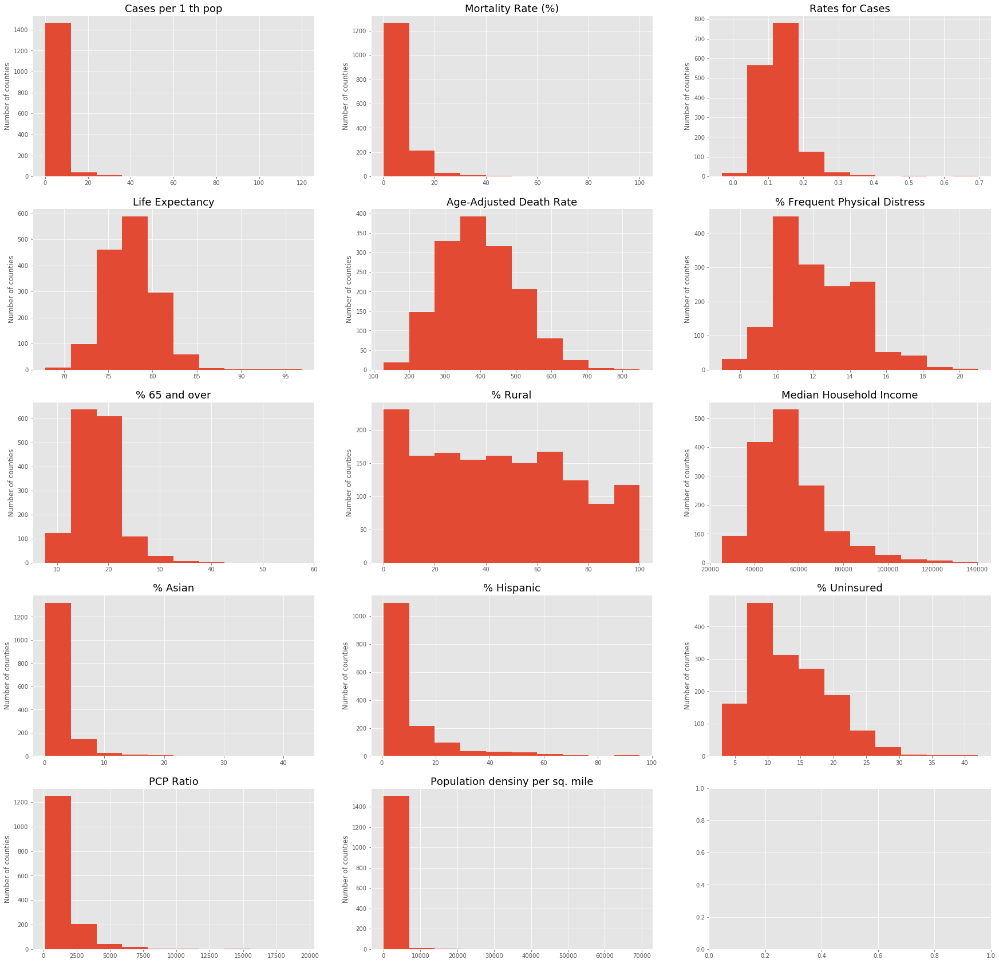

In [27]:
fig, axes = plt.subplots(nrows = 5, ncols = 3, figsize=(30,30))

counties_df['cases/1TH pop'].plot(kind='hist', ax = axes[0,0])
axes[0,0].set_title('Cases per 1 th pop', fontsize= 18)
axes[0,0].set_ylabel('Number of counties')

counties_df['Mortality Rate'].plot(kind='hist', ax = axes[0,1])
axes[0,1].set_title('Mortality Rate (%)', fontsize= 18)
axes[0,1].set_ylabel('Number of counties')

counties_df['RateCases'].plot(kind='hist', ax = axes[0,2])
axes[0,2].set_title('Rates for Cases', fontsize= 18)
axes[0,2].set_ylabel('Number of counties')

counties_df['Life Expectancy'].plot(kind='hist', ax = axes[1,0])
axes[1,0].set_title('Life Expectancy', fontsize= 18)
axes[1,0].set_ylabel('Number of counties')

counties_df['Age-Adjusted Death Rate'].plot(kind='hist', ax = axes[1,1])
axes[1,1].set_title('Age-Adjusted Death Rate', fontsize= 18)
axes[1,1].set_ylabel('Number of counties')

counties_df['% Frequent Physical Distress'].plot(kind='hist', ax = axes[1,2])
axes[1,2].set_title('% Frequent Physical Distress', fontsize= 18)
axes[1,2].set_ylabel('Number of counties')

counties_df['% 65 and over'].plot(kind='hist', ax = axes[2,0])
axes[2,0].set_title('% 65 and over', fontsize= 18)
axes[2,0].set_ylabel('Number of counties')

counties_df['% Rural'].plot(kind='hist', ax = axes[2,1])
axes[2,1].set_title('% Rural', fontsize= 18)
axes[2,1].set_ylabel('Number of counties')

counties_df['Median Household Income'].plot(kind='hist', ax = axes[2,2])
axes[2,2].set_title('Median Household Income', fontsize= 18)
axes[2,2].set_ylabel('Number of counties')

counties_df['% Asian'].plot(kind='hist', ax = axes[3,0])
axes[3,0].set_title('% Asian', fontsize= 18)
axes[3,0].set_ylabel('Number of counties')

counties_df['% Hispanic'].plot(kind='hist', ax = axes[3,1])
axes[3,1].set_title('% Hispanic', fontsize= 18)
axes[3,1].set_ylabel('Number of counties')

counties_df['% Uninsured'].plot(kind='hist', ax = axes[3,2])
axes[3,2].set_title('% Uninsured', fontsize= 18)
axes[3,2].set_ylabel('Number of counties')

counties_df['PCP Ratio'].plot(kind='hist', ax = axes[4,0])
axes[4,0].set_title('PCP Ratio', fontsize= 18)
axes[4,0].set_ylabel('Number of counties')

counties_df['Density'].plot(kind='hist', ax = axes[4,1])
axes[4,1].set_title('Population densiny per sq. mile', fontsize= 18)
axes[4,1].set_ylabel('Number of counties')

fig.show
plt.savefig('HistoOrig.png')

In [28]:
#Log transformation
counties_df['LogCases/1TH pop']=np.log10(counties_df['cases/1TH pop'])
counties_df['LogMortalityRate']=np.log10(counties_df['Mortality Rate'])
counties_df['LogMedianHhIncome']=np.log10(counties_df['Median Household Income'])
counties_df['LogAsian']=np.log10(counties_df['% Asian'])
counties_df['LogHispanic']=np.log10(counties_df['% Hispanic'])
counties_df['LogPCPRatio']=np.log10(counties_df['PCP Ratio'])
counties_df['LogDensity']=np.log10(counties_df['Density'])

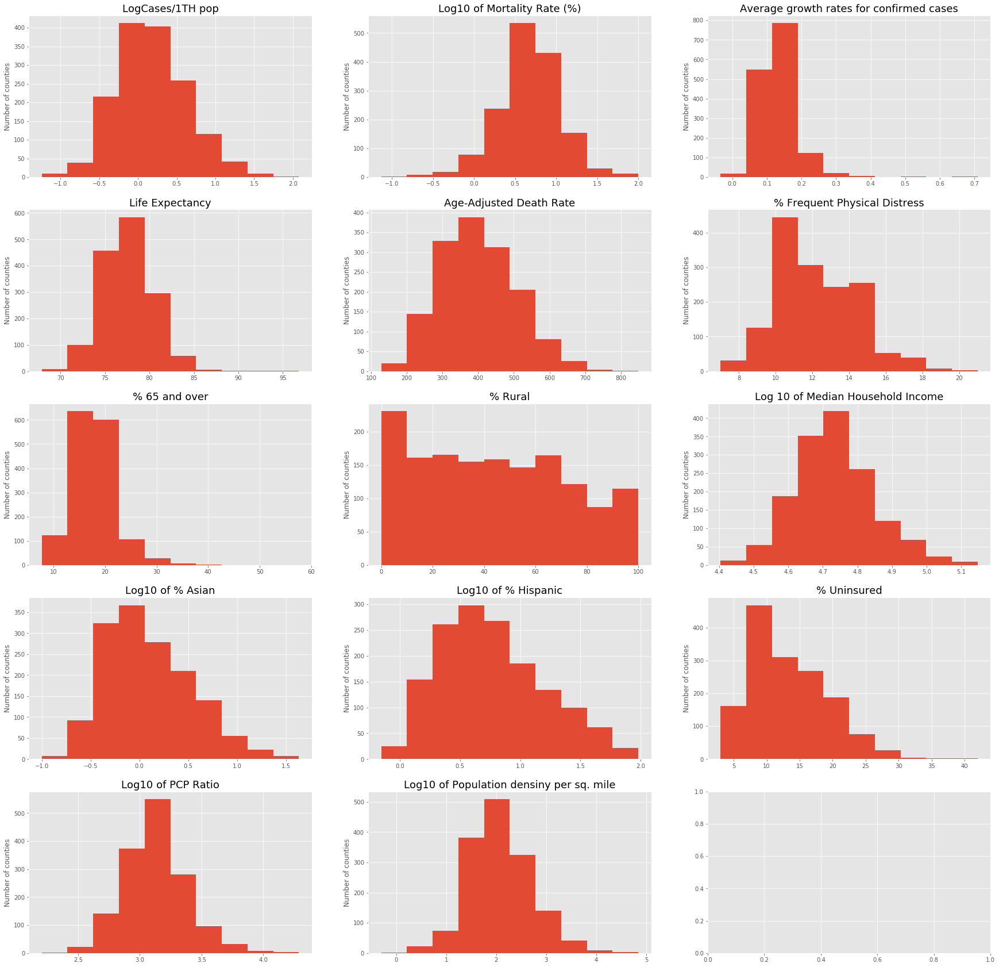

In [167]:
fig, axes = plt.subplots(nrows = 5, ncols = 3, figsize=(30,30))

counties_df['LogCases/1TH pop'].plot(kind='hist', ax = axes[0,0])
axes[0,0].set_title('LogCases/1TH pop', fontsize= 18)
axes[0,0].set_ylabel('Number of counties')

counties_df['LogMortalityRate'].plot(kind='hist', ax = axes[0,1])
axes[0,1].set_title('Log10 of Mortality Rate (%)', fontsize= 18)
axes[0,1].set_ylabel('Number of counties')

counties_df['RateCases'].plot(kind='hist', ax = axes[0,2])
axes[0,2].set_title('Average growth rates for confirmed cases', fontsize= 18)
axes[0,2].set_ylabel('Number of counties')

counties_df['Life Expectancy'].plot(kind='hist', ax = axes[1,0])
axes[1,0].set_title('Life Expectancy', fontsize= 18)
axes[1,0].set_ylabel('Number of counties')

counties_df['Age-Adjusted Death Rate'].plot(kind='hist', ax = axes[1,1])
axes[1,1].set_title('Age-Adjusted Death Rate', fontsize= 18)
axes[1,1].set_ylabel('Number of counties')

counties_df['% Frequent Physical Distress'].plot(kind='hist', ax = axes[1,2])
axes[1,2].set_title('% Frequent Physical Distress', fontsize= 18)
axes[1,2].set_ylabel('Number of counties')

counties_df['% 65 and over'].plot(kind='hist', ax = axes[2,0])
axes[2,0].set_title('% 65 and over', fontsize= 18)
axes[2,0].set_ylabel('Number of counties')

counties_df['% Rural'].plot(kind='hist', ax = axes[2,1])
axes[2,1].set_title('% Rural', fontsize= 18)
axes[2,1].set_ylabel('Number of counties')

counties_df['LogMedianHhIncome'].plot(kind='hist', ax = axes[2,2])
axes[2,2].set_title('Log 10 of Median Household Income', fontsize= 18)
axes[2,2].set_ylabel('Number of counties')

counties_df['LogAsian'].plot(kind='hist', ax = axes[3,0])
axes[3,0].set_title('Log10 of % Asian', fontsize= 18)
axes[3,0].set_ylabel('Number of counties')

counties_df['LogHispanic'].plot(kind='hist', ax = axes[3,1])
axes[3,1].set_title('Log10 of % Hispanic', fontsize= 18)
axes[3,1].set_ylabel('Number of counties')

counties_df['% Uninsured'].plot(kind='hist', ax = axes[3,2])
axes[3,2].set_title('% Uninsured', fontsize= 18)
axes[3,2].set_ylabel('Number of counties')

counties_df['LogPCPRatio'].plot(kind='hist', ax = axes[4,0])
axes[4,0].set_title('Log10 of PCP Ratio', fontsize= 18)
axes[4,0].set_ylabel('Number of counties')

counties_df['LogDensity'].plot(kind='hist', ax = axes[4,1])
axes[4,1].set_title('Log10 of Population densiny per sq. mile', fontsize= 18)
axes[4,1].set_ylabel('Number of counties')

fig.show
plt.savefig('HistoLog.png')

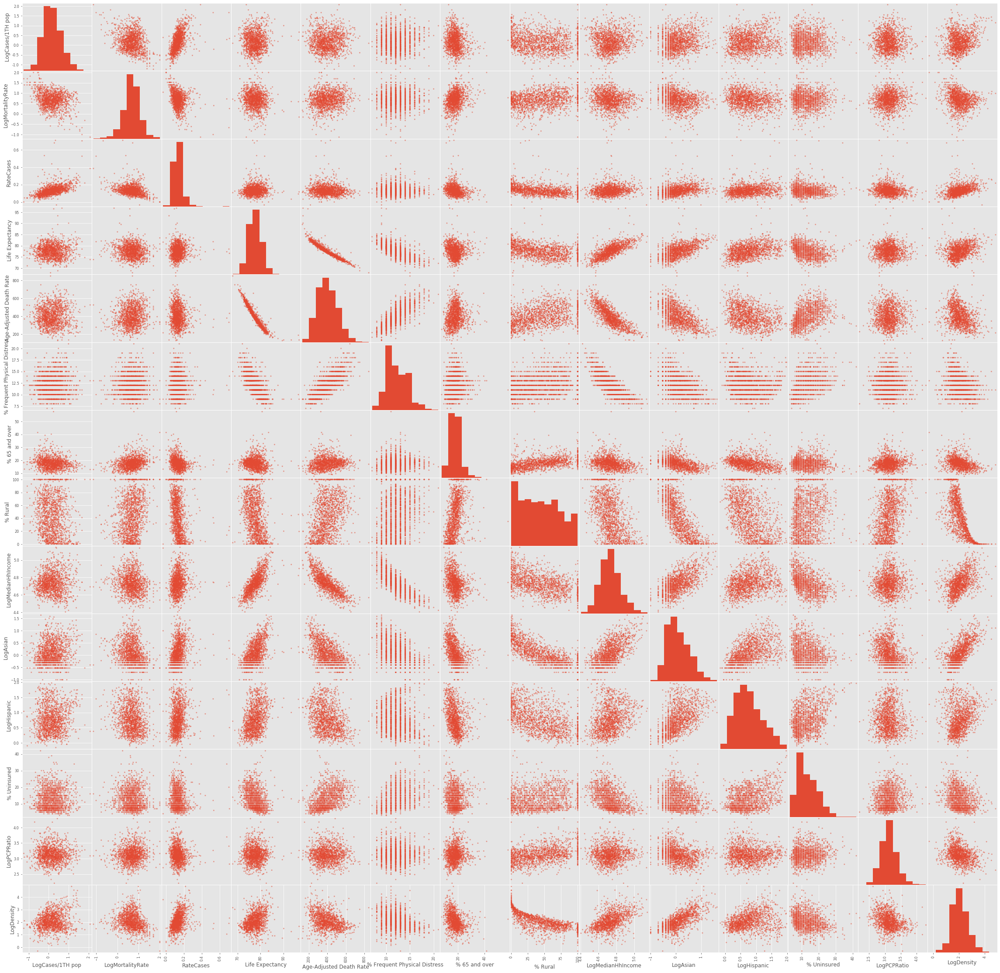

In [159]:
pd.plotting.scatter_matrix(counties_df[['LogCases/1TH pop', 'LogMortalityRate', 'RateCases',
                                        'Life Expectancy', 'Age-Adjusted Death Rate',
                                        '% Frequent Physical Distress', '% 65 and over',
                                        '% Rural', 'LogMedianHhIncome',  'LogAsian', 'LogHispanic', '% Uninsured', 'LogPCPRatio', 'LogDensity'
                                       ]], figsize = (40,40));
plt.savefig('MatrixPlot.png')

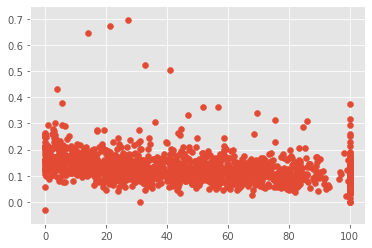

In [29]:
plt.scatter(counties_df['% Rural'], counties_df['RateCases'])

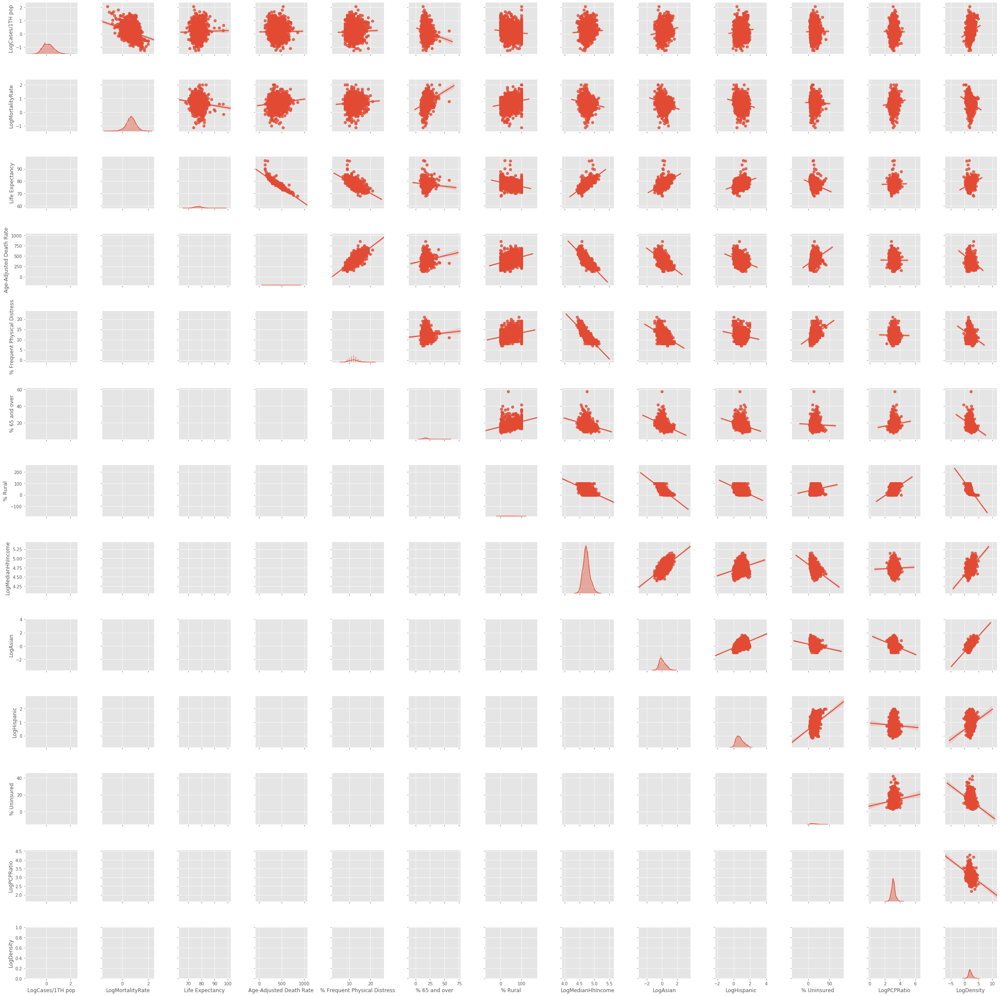

In [32]:
import seaborn as sns
g = sns.PairGrid(counties_df[['LogCases/1TH pop', 'LogMortalityRate', 
                                        'Life Expectancy', 'Age-Adjusted Death Rate',
                                        '% Frequent Physical Distress', '% 65 and over',
                                        '% Rural', 'LogMedianHhIncome',  'LogAsian', 'LogHispanic', '% Uninsured', 'LogPCPRatio', 'LogDensity'
                                       ]])
g.map_diag(sns.distplot)
g.map_upper(sns.regplot)

# 3.2 Folium mapping

In [47]:
import json # library to handle JSON files

!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

print('Libraries imported.')

Solving environment: done

## Package Plan ##

  environment location: /home/jupyterlab/conda/envs/python

  added / updated specs:
    - geopy


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    geographiclib-1.50         |             py_0          34 KB  conda-forge
    geopy-1.21.0               |             py_0          58 KB  conda-forge
    openssl-1.1.1g             |       h516909a_0         2.1 MB  conda-forge
    ------------------------------------------------------------
                                           Total:         2.2 MB

The following NEW packages will be INSTALLED:

  geographiclib      conda-forge/noarch::geographiclib-1.50-py_0
  geopy              conda-forge/noarch::geopy-1.21.0-py_0

The following packages will be UPDATED:

  openssl                                 1.1.1f-h516909a_0 --> 1.1.1g-h516909a_0



openssl-1.1.1g       | 2.1 MB    | ############

In [48]:
# center map at
address = 'USA'

geolocator = Nominatim(user_agent="us_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of USA are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of USA are 39.7837304, -100.4458825.


In [175]:
# create map of USA using latitude and longitude values
map_usa = folium.Map(location=[latitude, longitude], zoom_start=5)

# add markers to map
for lat, lng, label, size in zip(counties_df['Latitude'], counties_df['Longitude'], counties_df['County Name'], counties_df['cases/1TH pop']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=0.25*size,
        popup= label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_usa)  
    
map_usa

In [176]:
# create map of Northeast using latitude and longitude values
map_usa = folium.Map(location=[latitude, longitude], zoom_start=5)

# add markers to map
for lat, lng, label, size in zip(counties_df['Latitude'], counties_df['Longitude'], counties_df['County Name'], counties_df['Mortality Rate']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=0.2*size,
        popup= label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_usa)  
    
map_usa

In [177]:
# create map of Northeast using latitude and longitude values
map_usa = folium.Map(location=[latitude, longitude], zoom_start=5)

# add markers to map
for lat, lng, label, size in zip(counties_df['Latitude'], counties_df['Longitude'], counties_df['County Name'], counties_df['RateCases']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=20*size,
        popup= label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_usa)  
    
map_usa

In [178]:
# download states geojson file
!wget --quiet https://gist.githubusercontent.com/wrobstory/5586482/raw/6031540596a4ff6cbfee13a5fc894588422fd3e6/us-counties.json -O us-counties.json
    
print('GeoJSON file downloaded!')
county_geo = 'us-counties.json'

GeoJSON file downloaded!


In [216]:
m = folium.Map(location=[latitude, longitude], zoom_start=5)
m.choropleth(
    geo_data=county_geo,
    name='choropleth',
    data=counties_df,
    columns=['countyFIPS','RateCases'],
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Cases rate',
#    threshold_scale=[0.05, 0.15, 0,25, 0.5, 0.8]
)

#folium.LayerControl().add_to(m)

m

In [217]:
m = folium.Map(location=[latitude, longitude], zoom_start=5)
m.choropleth(
    geo_data=county_geo,
    name='choropleth',
    data=counties_df,
    columns=['countyFIPS','Mortality Rate'],
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Mortality Rate',
#    threshold_scale=[0.05, 0.15, 0,25, 0.5, 0.8]
)

#folium.LayerControl().add_to(m)

m

In [219]:
m = folium.Map(location=[latitude, longitude], zoom_start=5)
m.choropleth(
    geo_data=county_geo,
    name='choropleth',
    data=counties_df,
    columns=['countyFIPS','cases/1TH pop'],
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='cases/1TH pop',
#    threshold_scale=[0.05, 0.15, 0,25, 0.5, 0.8]
)

#folium.LayerControl().add_to(m)

m

# 3.3 Exploration and clustering

In [33]:
# @hidden_cell
CLIENT_ID = '3VZGJMFJALWAXJ3E1Z0MCVSC5JXCJYQYL5B0SSTAE1BRNCJB' # your Foursquare ID
CLIENT_SECRET = 'ZCQG42L1UOZ00SD4EXCHCSKFZTWXCPVLYXXXAG0CCFENSRLE' # your Foursquare Secret
VERSION = '20200502' # Foursquare API version

In [34]:
# type your answer here
LIMIT = 30 # limit of number of venues returned by Foursquare API
radius = 40000

In [35]:
def getNearbyVenues(names, countyFIPS, latitudes, longitudes):
    
    venues_list=[]
    for name, countyID, lat, lng in zip(names, countyFIPS, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()['response']['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            countyID,
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['County',
                  'countyFIPS',
                  'County Latitude', 
                  'County Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [34]:
#counties_venues = getNearbyVenues(names=counties_df['County Name'],
#                                  countyFIPS=counties_df['countyFIPS'],
#                                   latitudes=counties_df['Latitude'],
#                                   longitudes=counties_df['Longitude']
#                                  )

In [36]:
counties_venues = pd.read_csv('counties_venues_ALL_NonZeroMort.csv')
#counties_venues['countyFIPS'] = counties_venues['countyFIPS'].astype('str')
#counties_venues['County Name/FIPS'] = counties_venues['County'] + counties_venues['countyFIPS']
print(counties_venues.shape)

(44300, 9)


In [37]:
#counties_venues.to_csv('counties_venues_ALL_NonZeroMort.csv', index = False)

In [38]:
counties_venues.groupby('County Name/FIPS').count()

,County,countyFIPS,County Latitude,County Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
County Name/FIPS,,,,,,,,
Acadia Parish22001,30,30,30,30,30,30,30,30
Accomack County51001,30,30,30,30,30,30,30,30
Ada County16001,30,30,30,30,30,30,30,30
Adair County21001,30,30,30,30,30,30,30,30
Adair County40001,30,30,30,30,30,30,30,30
...,...,...,...,...,...,...,...,...
York County45091,30,30,30,30,30,30,30,30
York County51199,30,30,30,30,30,30,30,30
Young County48503,30,30,30,30,30,30,30,30


In [ ]:
# create map of Manhattan using latitude and longitude values
map_usa = folium.Map(location=[latitude, longitude], zoom_start=6)

# add markers to map
for lat, lng, label in zip(counties_venues['Venue Latitude'], counties_venues['Venue Longitude'], counties_venues['Venue']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=3,
        popup= label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_usa)  
    
map_usa

## Analyze Each County

In [39]:
# show all (not truncated dataframes)
pd.set_option('display.max_columns', None)  

# one hot encoding
counties_onehot = pd.get_dummies(counties_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
counties_onehot['County Name/FIPS'] = counties_venues['County Name/FIPS'] 

# move neighborhood column to the first column
fixed_columns = [counties_onehot.columns[-1]] + list(counties_onehot.columns[:-1])
counties_onehot = counties_onehot[fixed_columns]

counties_onehot.head()

,County Name/FIPS,ATM,Accessories Store,Adult Boutique,Advertising Agency,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Amphitheater,Animal Shelter,Antique Shop,Apres Ski Bar,Aquarium,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Basketball Stadium,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Shop,Bistro,Board Shop,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Bulgarian Restaurant,Burger Joint,Burrito Place,Bus Station,Business Service,Butcher,Café,Cajun / Creole Restaurant,Camera Store,Campground,Canal,Canal Lock,Candy Store,Capitol Building,Car Wash,Caribbean Restaurant,Casino,Castle,Cave,Cemetery,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Churrascaria,Cidery,City,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College & University,College Administrative Building,College Arts Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Engineering Building,College Football Field,College Gym,College Hockey Rink,College Library,College Quad,College Rec Center,College Stadium,College Theater,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Diner,Disc Golf,Discount Store,Distillery,Dive Bar,Dive Shop,Doctor's Office,Dog Run,Donut Shop,Drive-in Theater,Drugstore,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Fabric Shop,Factory,Fair,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Festival,Field,Filipino Restaurant,Fireworks Store,Fish & Chips Shop,Fish Market,Fishing Spot,Fishing Store,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General College & University,General Entertainment,General Travel,German Restaurant,Gift Shop,Gluten-free Restaurant,Go Kart Track,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gun Shop,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Hill,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Arena,Hockey Rink,Home Service,Hookah Bar,Hospital,Hostel,Hot Dog Joint,Hot Spring,Hotel,Hotel Bar,Housing Development,Hunan Restaurant,Hunting Supply,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Inn,Internet Cafe,Intersection,Irish Pub,Island,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Library,Lighthouse,Lingerie Store,Liquor Store,Lounge,Mac & Cheese Joint,Malay Restaurant,Marijuana Dispensary,Market,Martial Arts Dojo,Massage Studio,Medical Center,Medical School,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Mongolian R

In [40]:
counties_onehot.shape

(44300, 472)

In [41]:
counties_grouped = counties_onehot.groupby('County Name/FIPS').mean().reset_index()
counties_grouped

,County Name/FIPS,ATM,Accessories Store,Adult Boutique,Advertising Agency,Airport,Airport Lounge,Airport Service,Airport Terminal,American Restaurant,Amphitheater,Animal Shelter,Antique Shop,Apres Ski Bar,Aquarium,Arcade,Arepa Restaurant,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Basketball Stadium,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Beer Store,Big Box Store,Bike Shop,Bistro,Board Shop,Boat or Ferry,Bookstore,Border Crossing,Botanical Garden,Boutique,Bowling Alley,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Bulgarian Restaurant,Burger Joint,Burrito Place,Bus Station,Business Service,Butcher,Café,Cajun / Creole Restaurant,Camera Store,Campground,Canal,Canal Lock,Candy Store,Capitol Building,Car Wash,Caribbean Restaurant,Casino,Castle,Cave,Cemetery,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Churrascaria,Cidery,City,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Shop,College & University,College Administrative Building,College Arts Building,College Auditorium,College Baseball Diamond,College Basketball Court,College Bookstore,College Cafeteria,College Engineering Building,College Football Field,College Gym,College Hockey Rink,College Library,College Quad,College Rec Center,College Stadium,College Theater,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Czech Restaurant,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Diner,Disc Golf,Discount Store,Distillery,Dive Bar,Dive Shop,Doctor's Office,Dog Run,Donut Shop,Drive-in Theater,Drugstore,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Empanada Restaurant,English Restaurant,Ethiopian Restaurant,Event Space,Exhibit,Fabric Shop,Factory,Fair,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Festival,Field,Filipino Restaurant,Fireworks Store,Fish & Chips Shop,Fish Market,Fishing Spot,Fishing Store,Flea Market,Flower Shop,Fondue Restaurant,Food,Food & Drink Shop,Food Court,Food Service,Food Stand,Food Truck,Football Stadium,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General College & University,General Entertainment,General Travel,German Restaurant,Gift Shop,Gluten-free Restaurant,Go Kart Track,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gun Shop,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Heliport,High School,Hill,Himalayan Restaurant,Historic Site,History Museum,Hobby Shop,Hockey Arena,Hockey Rink,Home Service,Hookah Bar,Hospital,Hostel,Hot Dog Joint,Hot Spring,Hotel,Hotel Bar,Housing Development,Hunan Restaurant,Hunting Supply,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Inn,Internet Cafe,Intersection,Irish Pub,Island,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Library,Lighthouse,Lingerie Store,Liquor Store,Lounge,Mac & Cheese Joint,Malay Restaurant,Marijuana Dispensary,Market,Martial Arts Dojo,Massage Studio,Medical Center,Medical School,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Molecular Gastronomy Restaurant,Mongolian R

In [42]:
num_top_venues = 20

for county in counties_grouped['County Name/FIPS']:
    print("----"+county+"----")
    temp = counties_grouped[counties_grouped['County Name/FIPS'] == county].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
#    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Acadia Parish22001----


----Accomack County51001----


----Ada County16001----


----Adair County21001----


----Adair County40001----


----Adams County17001----


----Adams County18001----


----Adams County28001----


----Adams County31001----


----Adams County42001----


----Adams County55001----


----Adams County8001----


----Addison County50001----


----Aiken County45003----


----Alachua County12001----


----Alamance County37001----


----Alameda County6001----


----Alamosa County8003----


----Albany County36001----


----Albemarle County51003----


----Alcona County26001----


----Alcorn County28003----


----Alexandria City51510----


----Allamakee County19005----


----Allegan County26005----


----Allegany County24001----


----Allegany County36003----


----Allegheny County42003----


----Allen County18003----


----Allen County39003----


----Allen Parish22003----


----Allendale County45005----


----Alpena County26007----


----Amelia County51007----


----Am

In [43]:
# a function to sort the venues in descending order.
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [44]:
num_top_venues = 20

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['County Name/FIPS']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
counties_venues_sorted = pd.DataFrame(columns=columns)
counties_venues_sorted['County Name/FIPS'] = counties_grouped['County Name/FIPS']

for ind in np.arange(counties_grouped.shape[0]):
    counties_venues_sorted.iloc[ind, 1:] = return_most_common_venues(counties_grouped.iloc[ind, :], num_top_venues)

counties_venues_sorted.head()

,County Name/FIPS,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,Acadia Parish22001,Fast Food Restaurant,Cajun / Creole Restaurant,American Restaurant,Pizza Place,Burger Joint,Fried Chicken Joint,Breakfast Spot,Café,Mexican Restaurant,Sandwich Place,Bar,Gym,Pet Store,Pharmacy,Donut Shop,Seafood Restaurant,Hardware Store,Grocery Store,Food,Ice Cream Shop
1,Accomack County51001,Seafood Restaurant,Beach,Ice Cream Shop,Diner,Sandwich Place,Hotel,Pizza Place,Playground,Donut Shop,Trail,BBQ Joint,Science Museum,Taco Place,Bar,Deli / Bodega,Island,Irish Pub,Fish & Chips Shop,Farm,Ethiopian Restaurant
2,Ada County16001,Coffee Shop,Park,Brewery,Breakfast Spot,Bar,Scenic Lookout,College Football Field,Science Museum,Latin American Restaurant,Gym / Fitness Center,Movie Theater,Performing Arts Venue,Pizza Place,Beer Store,Mexican Restaurant,Other Great Outdoors,Dive Bar,Greek Restaurant,Pub,Italian Restaurant
3,Adair County21001,Fast Food Restaurant,Discount Store,Pizza Place,Gas Station,Mexican Restaurant,Diner,Supermarket,Gift Shop,Hardware Store,Sandwich Place,Sushi Restaurant,Department Store,Grocery Store,American Restaurant,Resort,State / Provincial Park,Ice Cream Shop,Food Service,Pharmacy,Fair
4,Adair County40001,American Restaurant,Mexican Restaurant,Italian Restaurant,State / Provincial Park,Café,Pizza Place,Hardware Store,Gym,Liquor Store,Asian Restaurant,Trail,Discount Store,Historic Site,Pharmacy,Supermarket,Department Store,Coffee Shop,Resort,Cajun / Creole Restaurant,Tex-Mex Restaurant


## Cluster Counties

In [45]:
counties_grouped_clustering = counties_grouped.drop('County Name/FIPS', 1)

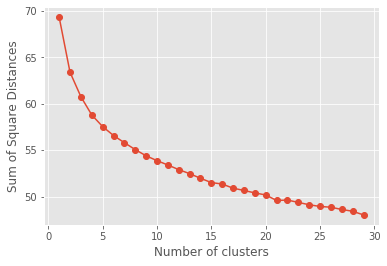

In [50]:
# find an optimal number of clusters by a scree plot
distortions = []
for i in range(1,30):
    km = KMeans(
        n_clusters = i, init = 'random',
        n_init = 5, max_iter=1000,
        tol=1e-05, random_state=0
    )
    km.fit(counties_grouped_clustering)
    distortions.append(km.inertia_)
    
# plot
plt.plot(range(1, 30), distortions, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Sum of Square Distances')
plt.savefig('ScreePlot.png')
plt.show()

In [49]:
# set number of clusters
kclusters = 5

counties_grouped_clustering = counties_grouped.drop('County Name/FIPS', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(counties_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([1, 2, 2, 4, 0, 0, 3, 0, 0, 0], dtype=int32)

In [50]:
# add clustering labels
counties_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

counties_merged = counties_df
counties_merged.head()

# merge counties_grouped with counties_data to add latitude/longitude for each state
counties_merged = counties_merged.merge(counties_venues_sorted, left_on='County Name/FIPS', right_on='County Name/FIPS')

counties_merged.head()

,countyFIPS,County Name,State,stateFIPS,totalCases,RateCases,totalDeaths,population,Density,cases/1TH pop,Mortality Rate,Latitude,Longitude,Life Expectancy,Age-Adjusted Death Rate,% Frequent Physical Distress,% Uninsured,PCP Ratio,Median Household Income,% 65 and over,% Asian,% Hispanic,% Rural,County Name/FIPS,LogCases/1TH pop,LogMortalityRate,LogMedianHhIncome,LogAsian,LogHispanic,LogPCPRatio,LogDensity,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,1001,Autauga County,AL,1,53,0.140573,3,55869,91.8,0.948648,5.660377,32.534922,-86.642743,76.9,418.0,14,11.0,2527.0,59338.0,15.6,1.2,3.0,42.0,Autauga County1001,-0.022895,0.752845,4.773333,0.079181,0.477121,3.402605,1.962843,1,Park,Ice Cream Shop,Fast Food Restaurant,Grocery Store,Steakhouse,Sporting Goods Shop,Gym,Farmers Market,Pet Store,Sandwich Place,Gas Station,Arts & Crafts Store,Fried Chicken Joint,Pizza Place,Sushi Restaurant,Italian Restaurant,Seafood Restaurant,Shoe Store,Deli / Bodega,Golf Course
1,1003,Baldwin County,AL,1,189,0.120491,5,223234,114.6,0.846645,2.645503,30.727484,-87.722570,78.5,353.0,12,14.0,1787.0,57588.0,20.4,1.2,4.6,42.3,Baldwin County1003,-0.072299,0.422508,4.760332,0.079181,0.662758,3.252125,2.059185,1,Grocery Store,Seafood Restaurant,Fast Food Restaurant,Cajun / Creole Restaurant,Golf Course,Pizza Place,Furniture / Home Store,Shopping Mall,Pet Store,Hardware Store,Soccer Field,Bookstore,Asian Restaurant,Hotel,Gas Station,Mediterranean Restaurant,Movie Theater,American Restaurant,Cosmetics Shop,Field
2,1005,Barbour County,AL,1,47,0.153062,1,24686,31.0,1.903913,2.127660,31.869579,-85.393212,75.3,497.0,17,16.0,1914.0,34382.0,19.4,0.5,4.3,67.8,Barbour County1005,0.279647,0.327902,4.536331,-0.301030,0.633468,3.281942,1.491362,4,Discount Store,Fast Food Restaurant,Sandwich Place,Mexican Restaurant,BBQ Joint,American Restaurant,Fried Chicken Joint,Historic Site,Grocery Store,Donut Shop,Pharmacy,Gas Station,Pizza Place,Coffee Shop,Resort,Cajun / Creole Restaurant,Frozen Yogurt Shop,Sports Bar,Restaurant,Exhibit
3,1013,Butler County,AL,1,120,0.142126,2,19448,27.0,6.170300,1.666667,31.752441,-86.680292,72.9,609.0,17,15.0,1406.0,37365.0,20.3,1.3,1.5,71.2,Butler County1013,0.790306,0.221849,4.572465,0.113943,0.176091,3.147985,1.431364,4,Discount Store,Pharmacy,American Restaurant,Gas Station,Fast Food Restaurant,Sandwich Place,Fried Chicken Joint,BBQ Joint,History Museum,Breakfast Spot,Grocery Store,Restaurant,Rest Area,Gift Shop,Hotel,Mexican Restaurant,Pizza Place,Factory,Fabric Shop,Exhibit
4,1015,Calhoun County,AL,1,114,0.133572,3,113605,195.7,1.003477,2.631579,33.771419,-85.826050,73.0,575.0,15,15.0,1786.0,45400.0,17.7,1.0,3.9,33.7,Calhoun County1015,0.001507,0.420216,4.657056,0.000000,0.591065,3.251881,2.291591,3,Mexican Restaurant,Wings Joint,BBQ Joint,Fast Food Restaurant,National Park,Japanese Restaurant,Coffee Shop,Greek Restaurant,Bar,Gym,Seafood Restaurant,Science Museum,Hardware Store,College Football Field,Brewery,Sandwich Place,Deli / Bodega,Restaurant,Food Service,Burger Joint


In [71]:
cluster_counts =  counties_merged.groupby('Cluster Labels').count()
cluster_counts

,countyFIPS,County Name,State,stateFIPS,totalCases,RateCases,totalDeaths,population,Density,cases/1TH pop,Mortality Rate,Latitude,Longitude,Life Expectancy,Age-Adjusted Death Rate,% Frequent Physical Distress,% Uninsured,PCP Ratio,Median Household Income,% 65 and over,% Asian,% Hispanic,% Rural,County Name/FIPS,LogCases/1TH pop,LogMortalityRate,LogMedianHhIncome,LogAsian,LogHispanic,LogPCPRatio,LogDensity,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
Cluster Labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311,311
1,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250
2,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434,434
3,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344,344
4,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168,168


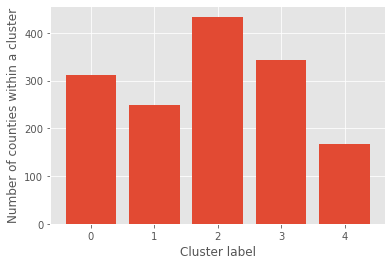

In [72]:
plt.bar(cluster_counts.index, cluster_counts['countyFIPS'])
plt.xlabel('Cluster label')
plt.ylabel('Number of counties within a cluster')
plt.savefig('ClusterCounts.png')
plt.show()

In [68]:
#create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=5)

# set color scheme for the clusters
#x = np.arange(kclusters)
#ys = [i + x + (i*x)**2 for i in range(kclusters)]
#colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
#rainbow = [colors.rgb2hex(i) for i in colors_array]
rainbow = ['orange', 'blue', 'green', 'purple', 'red']

# add markers to the map
#markers_colors = []

for cluster in range(0,kclusters): 
    group = folium.FeatureGroup(name='<span style=\\"color: {0};\\">{1}</span>'.format(rainbow[cluster-1],cluster))
    for lat, lon, poi, label in zip(counties_merged['Latitude'], counties_merged['Longitude'], counties_merged['County Name/FIPS'], counties_merged['Cluster Labels']):
        if int(label) == cluster:
            label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
            folium.CircleMarker(
                [lat, lon],
                radius=2,
                popup=label,
                color=rainbow[cluster-1],
                fill=True,
                fill_color=rainbow[cluster-1],
                fill_opacity=0.7).add_to(group)
    group.add_to(map_clusters)
folium.map.LayerControl('bottomright', collapsed=False).add_to(map_clusters)
#map_clusters.save(outfile= "map_clusters.html")
map_clusters

In [85]:
#create map Radius = Mortality Rate (%)
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=6)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster, size in zip(counties_merged['Latitude'], counties_merged['Longitude'], counties_merged['County Name/FIPS'], 
                                        counties_merged['Cluster Labels'], counties_merged['RateCases']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=10*size,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

In [57]:
counties_merged.head()

,countyFIPS,County Name,State,stateFIPS,totalCases,RateCases,totalDeaths,population,Density,cases/1TH pop,Mortality Rate,Latitude,Longitude,Life Expectancy,Age-Adjusted Death Rate,% Frequent Physical Distress,% Uninsured,PCP Ratio,Median Household Income,% 65 and over,% Asian,% Hispanic,% Rural,County Name/FIPS,LogCases/1TH pop,LogMortalityRate,LogMedianHhIncome,LogAsian,LogHispanic,LogPCPRatio,LogDensity,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,1001,Autauga County,AL,1,53,0.144001,3,55869,91.8,0.948648,5.660377,32.534922,-86.642743,76.9,418.0,14,11.0,2527.0,59338.0,15.6,1.2,3.0,42.0,Autauga County1001,-0.022895,0.752845,4.773333,0.079181,0.477121,3.402605,1.962843,1,Park,Ice Cream Shop,Fast Food Restaurant,Grocery Store,Steakhouse,Sporting Goods Shop,Gym,Farmers Market,Pet Store,Sandwich Place,Gas Station,Arts & Crafts Store,Fried Chicken Joint,Pizza Place,Sushi Restaurant,Italian Restaurant,Seafood Restaurant,Shoe Store,Deli / Bodega,Golf Course
1,1003,Baldwin County,AL,1,188,0.122749,4,223234,114.6,0.842166,2.127660,30.727484,-87.722570,78.5,353.0,12,14.0,1787.0,57588.0,20.4,1.2,4.6,42.3,Baldwin County1003,-0.074602,0.327902,4.760332,0.079181,0.662758,3.252125,2.059185,1,Grocery Store,Seafood Restaurant,Fast Food Restaurant,Cajun / Creole Restaurant,Golf Course,Pizza Place,Furniture / Home Store,Shopping Mall,Pet Store,Hardware Store,Soccer Field,Bookstore,Asian Restaurant,Hotel,Gas Station,Mediterranean Restaurant,Movie Theater,American Restaurant,Cosmetics Shop,Field
2,1005,Barbour County,AL,1,45,0.156566,1,24686,31.0,1.822896,2.222222,31.869579,-85.393212,75.3,497.0,17,16.0,1914.0,34382.0,19.4,0.5,4.3,67.8,Barbour County1005,0.260762,0.346787,4.536331,-0.301030,0.633468,3.281942,1.491362,4,Discount Store,Fast Food Restaurant,Sandwich Place,Mexican Restaurant,BBQ Joint,American Restaurant,Fried Chicken Joint,Historic Site,Grocery Store,Donut Shop,Pharmacy,Gas Station,Pizza Place,Coffee Shop,Resort,Cajun / Creole Restaurant,Frozen Yogurt Shop,Sports Bar,Restaurant,Exhibit
3,1013,Butler County,AL,1,114,0.144363,1,19448,27.0,5.861785,0.877193,31.752441,-86.680292,72.9,609.0,17,15.0,1406.0,37365.0,20.3,1.3,1.5,71.2,Butler County1013,0.768030,-0.056905,4.572465,0.113943,0.176091,3.147985,1.431364,4,Discount Store,Pharmacy,American Restaurant,Gas Station,Fast Food Restaurant,Sandwich Place,Fried Chicken Joint,BBQ Joint,History Museum,Breakfast Spot,Grocery Store,Restaurant,Rest Area,Gift Shop,Hotel,Mexican Restaurant,Pizza Place,Factory,Fabric Shop,Exhibit
4,1015,Calhoun County,AL,1,105,0.134590,3,113605,195.7,0.924255,2.857143,33.771419,-85.826050,73.0,575.0,15,15.0,1786.0,45400.0,17.7,1.0,3.9,33.7,Calhoun County1015,-0.034208,0.455932,4.657056,0.000000,0.591065,3.251881,2.291591,3,Mexican Restaurant,Wings Joint,BBQ Joint,Fast Food Restaurant,National Park,Japanese Restaurant,Coffee Shop,Greek Restaurant,Bar,Gym,Seafood Restaurant,Science Museum,Hardware Store,College Football Field,Brewery,Sandwich Place,Deli / Bodega,Restaurant,Food Service,Burger Joint


## Examine Clusters

In [69]:
counties0 = counties_merged.loc[counties_merged['Cluster Labels'] == 0, counties_merged.columns[[2] + list(range(5, counties_merged.shape[1]))]]

In [70]:
counties0.head(10)

,State,RateCases,totalDeaths,population,Density,cases/1TH pop,Mortality Rate,Latitude,Longitude,Life Expectancy,Age-Adjusted Death Rate,% Frequent Physical Distress,% Uninsured,PCP Ratio,Median Household Income,% 65 and over,% Asian,% Hispanic,% Rural,County Name/FIPS,LogCases/1TH pop,LogMortalityRate,LogMedianHhIncome,LogAsian,LogHispanic,LogPCPRatio,LogDensity,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
5,AL,0.156758,21,33254,57.4,9.141757,6.907895,32.914347,-85.392029,74.3,512.0,15,15.0,6723.0,39917.0,19.5,1.3,2.6,49.1,Chambers County1017,0.961030,0.839346,4.601158,0.113943,0.414973,3.827563,1.758912,0,American Restaurant,Pizza Place,Sandwich Place,Tourist Information Center,Supermarket,Golf Course,Mexican Restaurant,Gastropub,Grocery Store,Taco Place,Pharmacy,Fast Food Restaurant,Asian Restaurant,Mediterranean Restaurant,Frozen Yogurt Shop,Fried Chicken Joint,Salon / Barbershop,Japanese Restaurant,Brewery,Restaurant
20,AL,0.092917,1,17205,30.8,1.569311,3.703704,31.514704,-85.241414,76.2,466.0,14,15.0,4302.0,46027.0,22.7,0.4,2.7,87.8,Henry County1067,0.195709,0.568636,4.663013,-0.397940,0.431364,3.633670,1.488551,0,American Restaurant,Grocery Store,Fast Food Restaurant,Steakhouse,Mexican Restaurant,Sandwich Place,Bar,Pizza Place,Pet Store,Bakery,Breakfast Spot,Food Service,Donut Shop,Coffee Shop,Café,Thai Restaurant,Hotel,Ice Cream Shop,Other Great Outdoors,Falafel Restaurant
21,AL,0.126474,4,105882,175.1,0.925559,4.081633,31.153200,-85.302474,75.9,441.0,14,14.0,620.0,47993.0,17.8,1.1,3.4,33.8,Houston County1069,-0.033596,0.610834,4.681178,0.041393,0.531479,2.792392,2.243286,0,American Restaurant,Grocery Store,Pizza Place,Fast Food Restaurant,Breakfast Spot,Coffee Shop,Mexican Restaurant,Bar,Bakery,Seafood Restaurant,Pet Store,Hardware Store,Donut Shop,Other Great Outdoors,Sandwich Place,Food Service,Brewery,Hotel,Café,Ice Cream Shop
25,AL,0.157513,28,164542,230.8,2.479610,6.862745,32.601146,-85.355471,78.2,356.0,14,13.0,1744.0,48937.0,11.9,4.2,3.8,27.4,Lee County1081,0.394383,0.836498,4.689637,0.623249,0.579784,3.241546,2.363236,0,Pizza Place,Golf Course,American Restaurant,Mexican Restaurant,College Rec Center,College Basketball Court,Taco Place,Pharmacy,Grocery Store,Auto Garage,Hardware Store,Gas Station,Sandwich Place,Salon / Barbershop,Frozen Yogurt Shop,Fried Chicken Joint,Brewery,Supermarket,Restaurant,Fast Food Restaurant
27,AL,0.124201,2,18068,35.2,2.269205,4.878049,32.385947,-85.692629,73.2,616.0,17,13.0,1085.0,32495.0,20.4,0.6,1.8,55.5,Macon County1087,0.355874,0.688246,4.511817,-0.221849,0.255273,3.035430,1.546543,0,Burger Joint,American Restaurant,Historic Site,Mexican Restaurant,Coffee Shop,Taco Place,College Basketball Court,Auto Garage,Smoothie Shop,Pharmacy,Mediterranean Restaurant,Grocery Store,Sushi Restaurant,Gastropub,Pizza Place,Sandwich Place,College Rec Center,Bagel Shop,Park,Forest
40,AL,0.158457,22,40367,58.1,7.506131,7.260726,32.862377,-85.797498,74.5,497.0,15,15.0,1157.0,42205.0,21.6,0.6,2.4,74.2,Tallapoosa County1123,0.875416,0.860980,4.625364,-0.221849,0.380211,3.063333,1.764176,0,American Restaurant,Discount Store,Grocery Store,Mexican Restaurant,Restaurant,Campground,Gym / Fitness Center,Gas Station,Pizza Place,Park,Southern / Soul Food Restaurant,Fried Chicken Joint,State / Provincial Park,National Park,Music Venue,Fishing Spot,Farmers Market,Fabric Shop,Factory,Food
47,AK,0.063168,1,108317,3.6,0.193875,4.761905,62.316219,-149.571416,79.3,333.0,11,17.0,1362.0,74649.0,11.9,1.8,5.1,50.3,Matanuska-Susitna Borough2170,-0.712477,0.677781,4.873024,0.255273,0.707570,3.134177,0.556303

In [67]:
# Counts of 5 most popular places
counties0_counts=counties0.iloc[:,28:38].apply(pd.Series.value_counts).sum(1).to_frame(name='Count').sort_values(by='Count',ascending=True)
counties0_counts.tail()

,Count
Bar,111.0
Coffee Shop,136.0
Mexican Restaurant,155.0
Pizza Place,182.0
American Restaurant,309.0


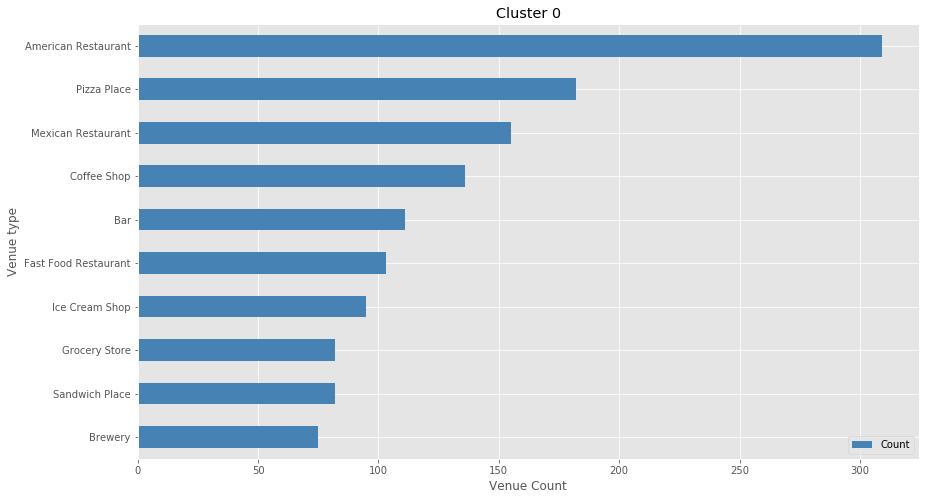

In [90]:
#Bar plot of 10 most popular venue categories
counties0_counts.tail(10).plot(kind='barh', figsize=(14, 8), color='steelblue')

plt.xlabel('Venue Count') # add to x-label to the plot
plt.ylabel('Venue type') # add y-label to the plot
plt.title('Cluster 0') # add title to the plot
plt.savefig('Figures/Cluster0_venues.png')

plt.show()

In [70]:
counties1 = counties_merged.loc[counties_merged['Cluster Labels'] == 1, counties_merged.columns[[2] + list(range(5, counties_merged.shape[1]))]]
counties1.head()

,State,RateCases,totalDeaths,population,Density,cases/1TH pop,Mortality Rate,Latitude,Longitude,Life Expectancy,Age-Adjusted Death Rate,% Frequent Physical Distress,% Uninsured,PCP Ratio,Median Household Income,% 65 and over,% Asian,% Hispanic,% Rural,County Name/FIPS,LogCases/1TH pop,LogMortalityRate,LogMedianHhIncome,LogAsian,LogHispanic,LogPCPRatio,LogDensity,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue,11th Most Common Venue,12th Most Common Venue,13th Most Common Venue,14th Most Common Venue,15th Most Common Venue,16th Most Common Venue,17th Most Common Venue,18th Most Common Venue,19th Most Common Venue,20th Most Common Venue
0,AL,0.144001,3,55869,91.8,0.948648,5.660377,32.534922,-86.642743,76.9,418.0,14,11.0,2527.0,59338.0,15.6,1.2,3.0,42.0,Autauga County1001,-0.022895,0.752845,4.773333,0.079181,0.477121,3.402605,1.962843,1,Park,Ice Cream Shop,Fast Food Restaurant,Grocery Store,Steakhouse,Sporting Goods Shop,Gym,Farmers Market,Pet Store,Sandwich Place,Gas Station,Arts & Crafts Store,Fried Chicken Joint,Pizza Place,Sushi Restaurant,Italian Restaurant,Seafood Restaurant,Shoe Store,Deli / Bodega,Golf Course
1,AL,0.122749,4,223234,114.6,0.842166,2.127660,30.727484,-87.722570,78.5,353.0,12,14.0,1787.0,57588.0,20.4,1.2,4.6,42.3,Baldwin County1003,-0.074602,0.327902,4.760332,0.079181,0.662758,3.252125,2.059185,1,Grocery Store,Seafood Restaurant,Fast Food Restaurant,Cajun / Creole Restaurant,Golf Course,Pizza Place,Furniture / Home Store,Shopping Mall,Pet Store,Hardware Store,Soccer Field,Bookstore,Asian Restaurant,Hotel,Gas Station,Mediterranean Restaurant,Movie Theater,American Restaurant,Cosmetics Shop,Field
13,AL,0.101537,3,37196,44.8,1.747500,4.615385,32.325974,-87.106474,71.2,664.0,18,14.0,1473.0,34035.0,18.1,0.6,1.1,45.6,Dallas County1047,0.242417,0.664208,4.531926,-0.221849,0.041393,3.168203,1.651278,1,Sandwich Place,Fried Chicken Joint,Grocery Store,Fast Food Restaurant,BBQ Joint,Pharmacy,History Museum,Pizza Place,Food,Steakhouse,Bridge,Mobile Phone Shop,Mexican Restaurant,Trail,Lounge,Seafood Restaurant,Burger Joint,Discount Store,Department Store,Hotel
15,AL,0.107242,3,81209,128.2,1.366844,2.702703,32.596647,-86.149159,75.9,431.0,13,11.0,2642.0,60367.0,15.1,0.7,3.0,54.2,Elmore County1051,0.135719,0.431798,4.780800,-0.154902,0.477121,3.421933,2.107888,1,Fast Food Restaurant,Grocery Store,BBQ Joint,Park,Fried Chicken Joint,Festival,Pharmacy,Donut Shop,Lingerie Store,Sushi Restaurant,Furniture / Home Store,Bar,Coffee Shop,Restaurant,Deli / Bodega,American Restaurant,Steakhouse,Mexican Restaurant,Zoo,Wings Joint
32,AL,0.199573,66,413210,335.9,2.957334,5.400982,30.787207,-88.205809,75.1,496.0,14,15.0,898.0,43598.0,16.2,2.1,3.1,20.0,Mobile County1097,0.470900,0.732473,4.639467,0.322219,0.491362,2.953276,2.526210,1,Grocery Store,Italian Restaurant,Mexican Restaurant,Fried Chicken Joint,Fast Food Restaurant,Greek Restaurant,Coffee Shop,Smoothie Shop,Pet Store,Donut Shop,Seafood Restaurant,Pizza Place,Golf Course,Pub,Deli / Bodega,Irish Pub,Café,Bubble Tea Shop,Flea Market,Event Space


In [75]:
counties1_counts=counties1.iloc[:,28:38].apply(pd.Series.value_counts).sum(1).to_frame(name='Count').sort_values(by='Count',ascending=True)
counties1_counts.tail()

,Count
Park,87.0
Pizza Place,94.0
Coffee Shop,100.0
Fast Food Restaurant,179.0
Grocery Store,235.0


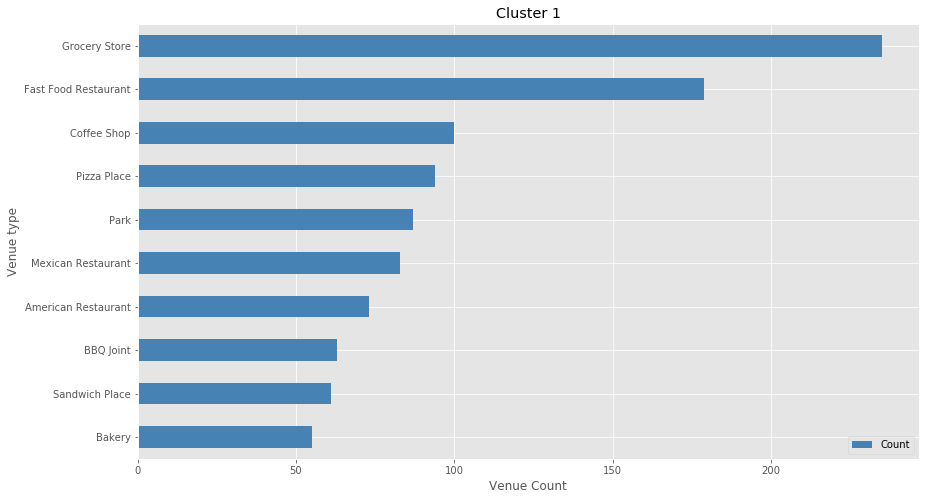

In [91]:
counties1_counts.tail(10).plot(kind='barh', figsize=(14, 8), color='steelblue')

plt.xlabel('Venue Count') # add to x-label to the plot
plt.ylabel('Venue type') # add y-label to the plot
plt.title('Cluster 1') # add title to the plot
plt.savefig('Figures/Cluster1_venues.png')

plt.show()

In [79]:
counties2 = counties_merged.loc[counties_merged['Cluster Labels'] == 2, counties_merged.columns[[2] + list(range(5, counties_merged.shape[1]))]]
counties2_counts=counties2.iloc[:,28:38].apply(pd.Series.value_counts).sum(1).to_frame(name='Count').sort_values(by='Count',ascending=True)
counties2_counts.tail()

,Count
Bar,151.0
Pizza Place,164.0
Brewery,212.0
Park,219.0
Coffee Shop,228.0


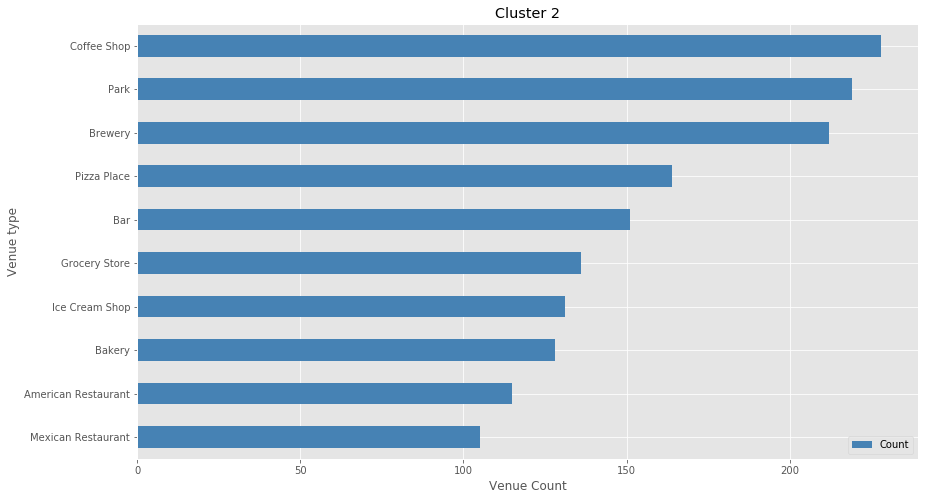

In [92]:
counties2_counts.tail(10).plot(kind='barh', figsize=(14, 8), color='steelblue')

plt.xlabel('Venue Count') # add to x-label to the plot
plt.ylabel('Venue type') # add y-label to the plot
plt.title('Cluster 2') # add title to the plot
plt.savefig('Figures/Cluster2_venues.png')

plt.show()

In [81]:
counties3 = counties_merged.loc[counties_merged['Cluster Labels'] == 3, counties_merged.columns[[2] + list(range(5, counties_merged.shape[1]))]]
counties3_counts=counties3.iloc[:,28:38].apply(pd.Series.value_counts).sum(1).to_frame(name='Count').sort_values(by='Count',ascending=True)
counties3_counts.tail()

,Count
Pizza Place,144.0
American Restaurant,162.0
Coffee Shop,198.0
Fast Food Restaurant,253.0
Mexican Restaurant,302.0


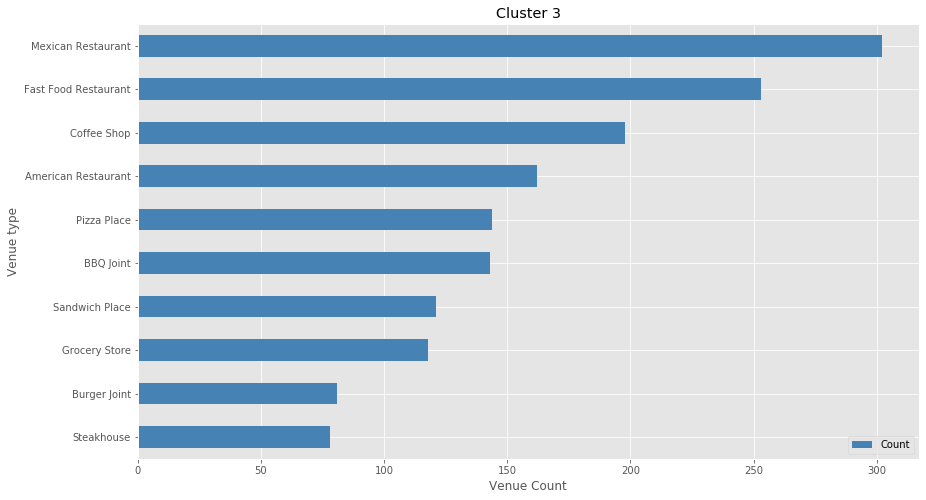

In [93]:
counties3_counts.tail(10).plot(kind='barh', figsize=(14, 8), color='steelblue')

plt.xlabel('Venue Count') # add to x-label to the plot
plt.ylabel('Venue type') # add y-label to the plot
plt.title('Cluster 3') # add title to the plot
plt.savefig('Figures/Cluster3_venues.png')

plt.show()

In [84]:
counties4 = counties_merged.loc[counties_merged['Cluster Labels'] == 4, counties_merged.columns[[2] + list(range(5, counties_merged.shape[1]))]]
counties4_counts=counties4.iloc[:,28:38].apply(pd.Series.value_counts).sum(1).to_frame(name='Count').sort_values(by='Count',ascending=True)
counties4_counts.tail()

,Count
Gas Station,78.0
Pizza Place,106.0
Sandwich Place,140.0
Fast Food Restaurant,154.0
Discount Store,166.0


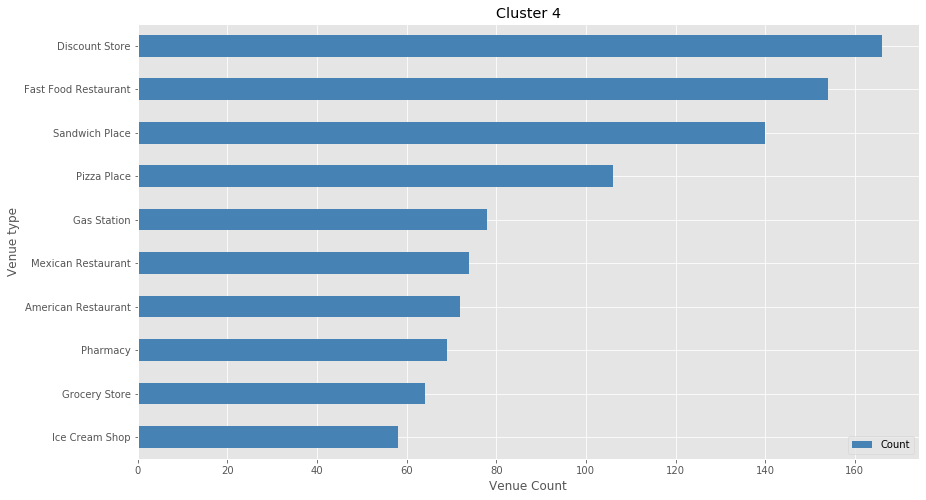

In [94]:
counties4_counts.tail(10).plot(kind='barh', figsize=(14, 8), color='steelblue')

plt.xlabel('Venue Count') # add to x-label to the plot
plt.ylabel('Venue type') # add y-label to the plot
plt.title('Cluster 4') # add title to the plot
plt.savefig('Figures/Cluster4_venues.png')

plt.show()

# 4 Results

# 4.1. Correlation between variables and Foursquare clusters. ANOVA

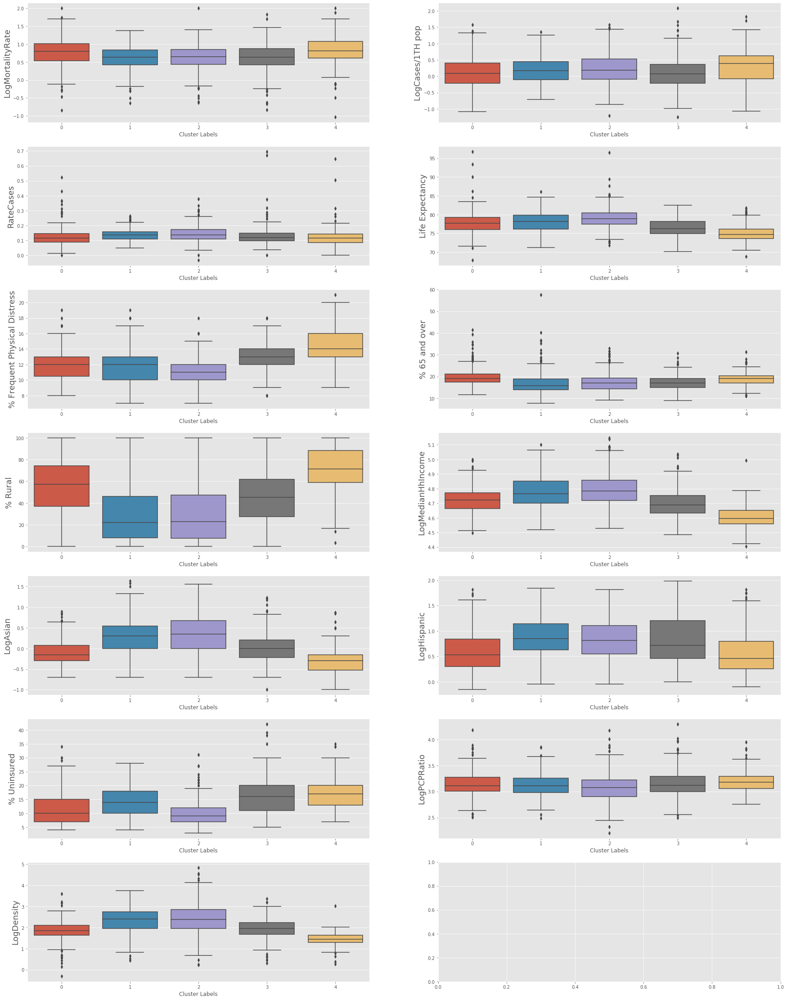

In [76]:
import seaborn as sns

fig, axes = plt.subplots(nrows = 7, ncols = 2, figsize=(30,40))

sns.boxplot(x='Cluster Labels', y='LogMortalityRate', data=counties_merged, ax=axes[0,0])
axes[0,0].set_ylabel('LogMortalityRate', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='LogCases/1TH pop', data=counties_merged, ax=axes[0,1])
axes[0,1].set_ylabel('LogCases/1TH pop', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='RateCases', data=counties_merged, ax=axes[1,0])
axes[1,0].set_ylabel('RateCases', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='Life Expectancy', data=counties_merged, ax=axes[1,1])
axes[1,1].set_ylabel('Life Expectancy', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='% Frequent Physical Distress', data=counties_merged, ax=axes[2,0])
axes[2,0].set_ylabel('% Frequent Physical Distress', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='% 65 and over', data=counties_merged, ax=axes[2,1])
axes[2,1].set_ylabel('% 65 and over', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='% Rural', data=counties_merged, ax=axes[3,0])
axes[3,0].set_ylabel('% Rural', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='LogMedianHhIncome', data=counties_merged, ax=axes[3,1])
axes[3,1].set_ylabel('LogMedianHhIncome', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='LogAsian', data=counties_merged, ax=axes[4,0])
axes[4,0].set_ylabel('LogAsian', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='LogHispanic', data=counties_merged, ax=axes[4,1])
axes[4,1].set_ylabel('LogHispanic', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='% Uninsured', data=counties_merged, ax=axes[5,0])
axes[5,0].set_ylabel('% Uninsured', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='LogPCPRatio', data=counties_merged, ax=axes[5,1])
axes[5,1].set_ylabel('LogPCPRatio', fontsize= 18)

sns.boxplot(x='Cluster Labels', y='LogDensity', data=counties_merged, ax=axes[6,0])
axes[6,0].set_ylabel('LogDensity', fontsize= 18)

fig.show
plt.savefig('Figures/ClusterBoxplots.png')

(0, 0.4)

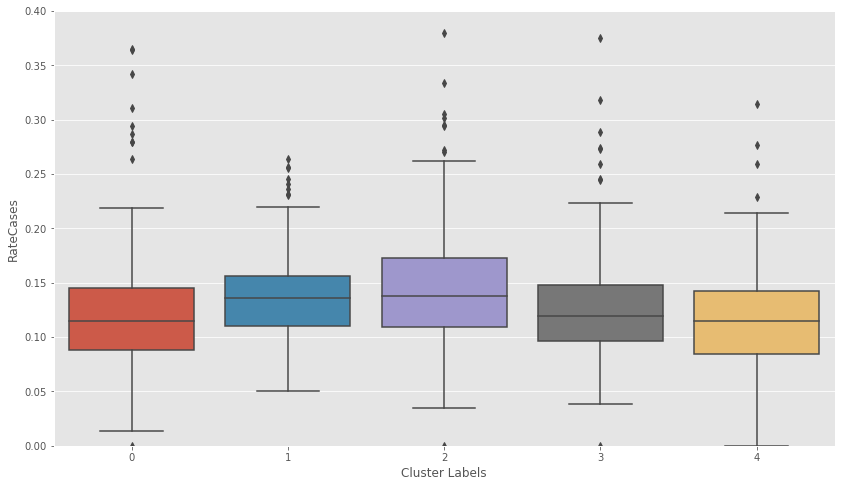

In [77]:
plt.figure(figsize=(14, 8))
sns.boxplot(x='Cluster Labels', y='RateCases', data=counties_merged)
plt.ylim(0, 0.4)

(0, 30)

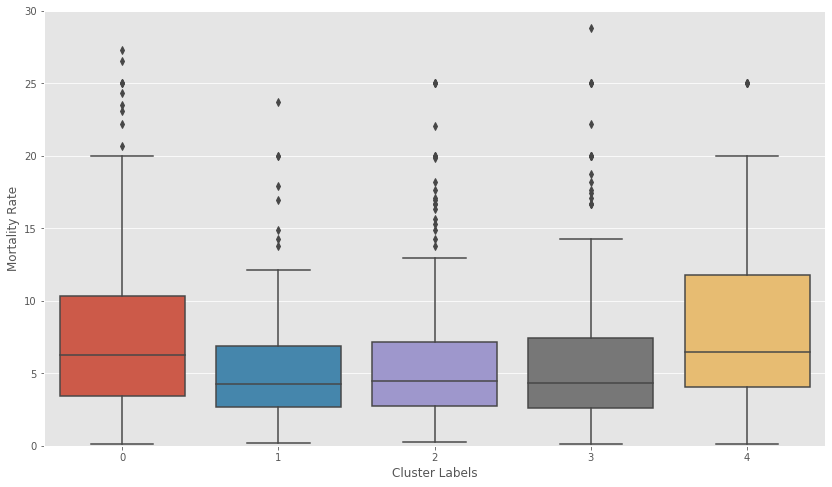

In [78]:
plt.figure(figsize=(14, 8))
sns.boxplot(x='Cluster Labels', y='Mortality Rate', data=counties_merged)
plt.ylim(0, 30)

(-1, 2)

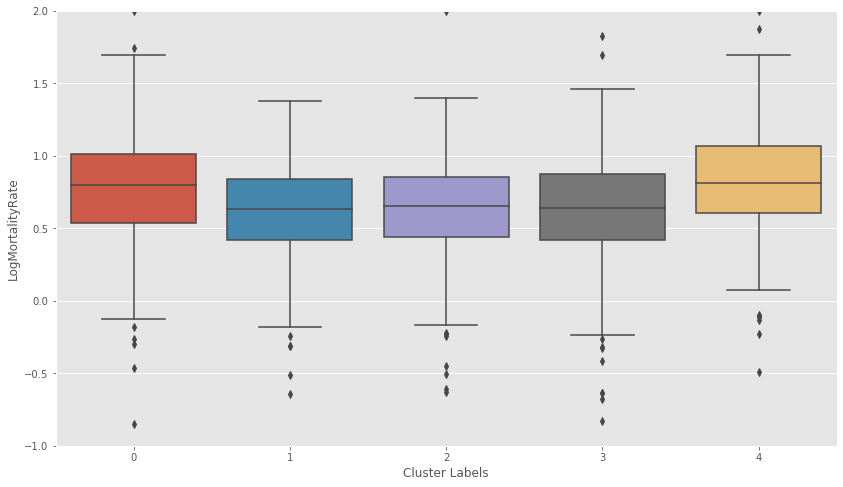

In [79]:
plt.figure(figsize=(14, 8))
sns.boxplot(x='Cluster Labels', y='LogMortalityRate', data=counties_merged)
plt.ylim(-1, 2)

(-1.5, 2)

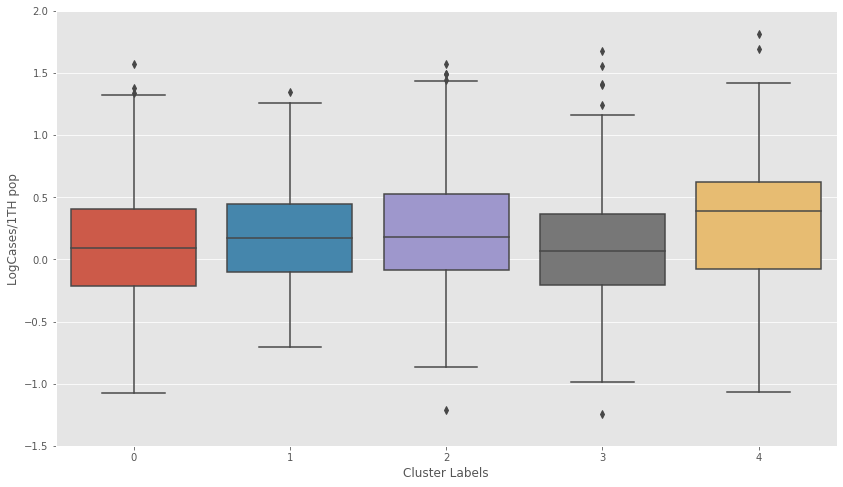

In [80]:
plt.figure(figsize=(14, 8))
sns.boxplot(x='Cluster Labels', y='LogCases/1TH pop', data=counties_merged)
plt.ylim(-1.5, 2)

In [81]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.formula.api import ols

In [86]:
# ANOVA
anova1 = smf.ols('Q("RateCases") ~ C(Q("Cluster Labels"))', data = counties_merged).fit()
aov_table = sm.stats.anova_lm(anova1, typ=2)
print(aov_table)

                          sum_sq      df         F        PR(>F)
C(Q("Cluster Labels"))  0.111190     4.0  9.072035  3.062154e-07
Residual                4.602237  1502.0       NaN           NaN


In [87]:
pair_t = anova1.t_test_pairwise('C(Q("Cluster Labels"))')
pair_t.result_frame

,coef,std err,t,P>|t|,Conf. Int. Low,Conf. Int. Upp.,pvalue-hs,reject-hs
1-0,0.014505,0.004702,3.084780,2.074192e-03,0.005281,0.023728,0.014429,True
2-0,0.020519,0.004112,4.989435,6.760554e-07,0.012452,0.028586,0.000007,True
3-0,0.005641,0.004331,1.302384,1.929850e-01,-0.002855,0.014137,0.528567,False
4-0,-0.001147,0.005300,-0.216380,8.287210e-01,-0.011543,0.009250,0.828721,False
2-1,0.006014,0.004395,1.368435,1.713807e-01,-0.002607,0.014635,0.528567,False
3-1,-0.008864,0.004600,-1.926723,5.420260e-02,-0.017888,0.000160,0.243184,False
4-1,-0.015651,0.005522,-2.834264,4.654595e-03,-0.026483,-0.004819,0.027605,True
3-2,-0.014878,0.003996,-3.723306,2.038963e-04,-0.022716,-0.007040,0.001630,True
4-2,-0.021666,0.005030,-4.307497,1.758240e-05,-0.031532,-0.011800,0.000158,True
4-3,-0.006788,0.005210,-1.302792,1.928455e-01,-0.017008,0.003432,0.528567,False


In [84]:
# ANOVA for Log Mortality Rate
anova2 = smf.ols('LogMortalityRate ~ C(Q("Cluster Labels"))', data = counties_merged).fit()
aov_table = sm.stats.anova_lm(anova2, typ=2)
print(aov_table)

                            sum_sq      df          F        PR(>F)
C(Q("Cluster Labels"))    8.926975     4.0  16.690786  2.155401e-13
Residual                200.834107  1502.0        NaN           NaN


In [85]:
pair_t = anova2.t_test_pairwise('C(Q("Cluster Labels"))')
pair_t.result_frame

,coef,std err,t,P>|t|,Conf. Int. Low,Conf. Int. Upp.,pvalue-hs,reject-hs
1-0,-0.170404,0.031061,-5.486118,4.814685e-08,-0.231332,-0.109477,4.814684e-07,True
2-0,-0.143487,0.027167,-5.281734,1.467593e-07,-0.196776,-0.090199,9.699801e-07,True
3-0,-0.154181,0.028612,-5.388735,8.227464e-08,-0.210305,-0.098058,6.581970e-07,True
4-0,0.027974,0.035012,0.798970,4.244344e-01,-0.040704,0.096651,8.258718e-01,False
2-1,0.026917,0.029033,0.927102,3.540226e-01,-0.030033,0.083867,8.258718e-01,False
3-1,0.016223,0.030390,0.533823,5.935427e-01,-0.043388,0.075834,8.347925e-01,False
4-1,0.198378,0.036479,5.438078,6.278120e-08,0.126822,0.269934,5.650307e-07,True
3-2,-0.010694,0.026397,-0.405129,6.854401e-01,-0.062472,0.041084,8.347925e-01,False
4-2,0.171461,0.033226,5.160387,2.793406e-07,0.106286,0.236636,1.396702e-06,True
4-3,0.182155,0.034418,5.292439,1.385686e-07,0.114643,0.249667,9.699801e-07,True


In [91]:
# ANOVA for Log Cases per 1TH pop
anova3 = smf.ols('Q("LogCases/1TH pop") ~ C(Q("Cluster Labels"))', data = counties_merged).fit()
aov_table = sm.stats.anova_lm(anova3, typ=2)
print(aov_table)

                            sum_sq      df          F        PR(>F)
C(Q("Cluster Labels"))    9.561145     4.0  11.337302  4.572943e-09
Residual                316.672312  1502.0        NaN           NaN


In [92]:
pair_t = anova3.t_test_pairwise('C(Q("Cluster Labels"))')
pair_t.result_frame

,coef,std err,t,P>|t|,Conf. Int. Low,Conf. Int. Upp.,pvalue-hs,reject-hs
1-0,0.113841,0.039003,2.918765,3.566540e-03,0.037335,0.190348,0.017706,True
2-0,0.138579,0.034113,4.062319,5.109680e-05,0.071664,0.205494,0.000358,True
3-0,-0.003995,0.035928,-0.111204,9.114695e-01,-0.074469,0.066479,0.911469,False
4-0,0.221809,0.043965,5.045171,5.082930e-07,0.135570,0.308047,0.000005,True
2-1,0.024737,0.036457,0.678534,4.975375e-01,-0.046775,0.096250,0.747531,False
3-1,-0.117837,0.038161,-3.087925,2.052503e-03,-0.192690,-0.042983,0.012252,True
4-1,0.107967,0.045807,2.356998,1.855110e-02,0.018115,0.197820,0.072165,False
3-2,-0.142574,0.033146,-4.301354,1.807090e-05,-0.207592,-0.077556,0.000145,True
4-2,0.083230,0.041722,1.994853,4.623935e-02,0.001390,0.165070,0.132403,False
4-3,0.225804,0.043219,5.224693,1.989442e-07,0.141029,0.310580,0.000002,True


# 4.2 Linear model for average COVID-19 Growth rate prediction

In [128]:
%pip install statsmodels
%pip install category_encoders

Note: you may need to restart the kernel to use updated packages.
     |████████████████████████████████| 81kB 4.6MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [129]:
from sklearn.preprocessing import OneHotEncoder
import category_encoders as ce

In [149]:
counties_merged['Cluster Labels']=counties_merged['Cluster Labels'].astype(str)

In [150]:
X = counties_merged[['Life Expectancy', '% Frequent Physical Distress',
                 '% 65 and over','% Rural', 'LogMedianHhIncome', '% Uninsured', 'LogAsian', 'LogHispanic', 'LogPCPRatio', 'LogDensity', 'Cluster Labels']]

In [135]:
encoder = ce.OneHotEncoder(use_cat_names=True)
X_transformed = encoder.fit_transform(X)
X_transformed.head()

,Life Expectancy,% Frequent Physical Distress,% 65 and over,% Rural,LogMedianHhIncome,% Uninsured,LogAsian,LogHispanic,LogPCPRatio,LogDensity,Cluster Labels_1,Cluster Labels_4,Cluster Labels_3,Cluster Labels_0,Cluster Labels_2
0,76.9,14,15.6,42.0,4.773333,11.0,0.079181,0.477121,3.402605,1.962843,1,0,0,0,0
1,78.5,12,20.4,42.3,4.760332,14.0,0.079181,0.662758,3.252125,2.059185,1,0,0,0,0
2,75.3,17,19.4,67.8,4.536331,16.0,-0.301030,0.633468,3.281942,1.491362,0,1,0,0,0
3,72.9,17,20.3,71.2,4.572465,15.0,0.113943,0.176091,3.147985,1.431364,0,1,0,0,0
4,73.0,15,17.7,33.7,4.657056,15.0,0.000000,0.591065,3.251881,2.291591,0,0,1,0,0


In [143]:
from sklearn import linear_model
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm

feature_names = X_transformed.columns.tolist()

regr = linear_model.LinearRegression()
x = np.asanyarray(X_transformed)
y = np.asanyarray(counties_merged[['RateCases']])
regr.fit (x, y)
# The coefficients
print ('Coefficients: ', regr.coef_)

Coefficients:  [[-0.00037649  0.00148949 -0.00137544 -0.00018217 -0.03314203 -0.00054164
   0.00288452  0.0119015   0.00802754  0.02556173 -0.00559346  0.007894
  -0.00387939  0.00211008 -0.00053124]]


In [145]:
x1 = sm.add_constant(x)
est = sm.OLS(y,x1).fit()
print(est.summary(xname = ['Const']+feature_names))

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.163
Model:                            OLS   Adj. R-squared:                  0.156
Method:                 Least Squares   F-statistic:                     20.82
Date:                Wed, 06 May 2020   Prob (F-statistic):           7.61e-49
Time:                        19:23:34   Log-Likelihood:                 2341.9
No. Observations:                1507   AIC:                            -4654.
Df Residuals:                    1492   BIC:                            -4574.
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
Const           

# 4.3 Random Forest Regressor for COVID-19 growth rates

In [154]:
%pip install graphviz

Note: you may need to restart the kernel to use updated packages.


In [155]:
feature_names_tree = ['Life Expectancy',
                 '% Frequent Physical Distress', '% 65 and over',
                 '% Rural', 'Median Household Income', '% Uninsured', '% Asian', '% Hispanic', 'PCP Ratio', 'Density', 'Cluster Labels'
                                       ]
X = counties_merged[feature_names_tree].values
y = counties_merged['RateCases']

In [158]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score
from sklearn import metrics
import graphviz
from sklearn.tree import export_graphviz
from sklearn import tree
from sklearn.feature_selection import RFE

In [166]:
X_trainset, X_testset, y_trainset, y_testset = train_test_split(X, y, test_size=0.2, random_state=3)

In [167]:
# your code
print("A shape of an X-training set: ", X_trainset.shape)
print("A shape of a Y-training set: ", y_trainset.shape)

A shape of an X-training set:  (1205, 11)
A shape of a Y-training set:  (1205,)


In [168]:
print("A shape of an X-test set: ", X_testset.shape)
print("A shape of a Y-test set: ", y_testset.shape)

A shape of an X-test set:  (302, 11)
A shape of a Y-test set:  (302,)


In [180]:
forest_model = RandomForestRegressor(random_state=1, n_estimators=1000, max_depth = 4)
forest_model.fit(X_trainset, y_trainset)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=4,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=1000, n_jobs=None,
           oob_score=False, random_state=1, verbose=0, warm_start=False)

In [181]:
y_1 = forest_model.predict(X_testset)
estimator = forest_model.estimators_[0]

In [182]:
print("MAE: ", mean_absolute_error(y_testset, y_1))
print("R2 Score: ", r2_score(y_testset, y_1))
print("Adj R2: ", 1-(1-r2_score(y_testset, y_1))*(302-1)/(302-11-1))

MAE:  0.034025109346258305
R2 Score:  0.23432084493190175
Adj R2:  0.20527784249828418


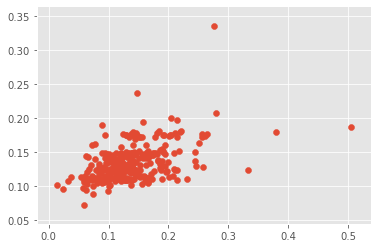

In [183]:
plt.scatter(y_testset, y_1)

In [184]:
#plot one of the trees from the forest
tree.export_graphviz(estimator, out_file='RandomTree_Regr_RateCases.dot', feature_names = feature_names_tree,
                     class_names= np.unique(y_trainset).astype('str'), filled = True, rounded = True, precision = 2) 
# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'RandomTree_Regr_RateCases.dot', '-o', 'RandomTree_Regr_RateCases.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'RandomTree_Regr_RateCases.png')

In [185]:
y = forest_model.feature_importances_

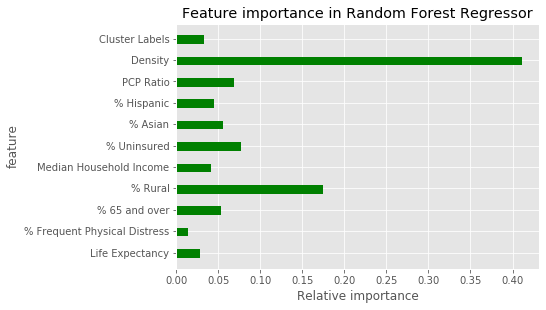

<Figure size 360x360 with 0 Axes>

In [189]:
#plot
fig, ax = plt.subplots() 
width = 0.4 # the width of the bars 
ind = np.arange(len(y)) # the x locations for the groups
ax.barh(ind, y, width, color='green')
ax.set_yticks(ind+width/10)
ax.set_yticklabels(feature_names_tree, minor=False)
plt.title('Feature importance in Random Forest Regressor')
plt.xlabel('Relative importance')
plt.ylabel('feature') 
plt.figure(figsize=(5,5))
fig.set_size_inches(6.5, 4.5, forward=True)

fig.show
plt.savefig('Figures/RandomForest Features importance.png')

# 5. Discussion

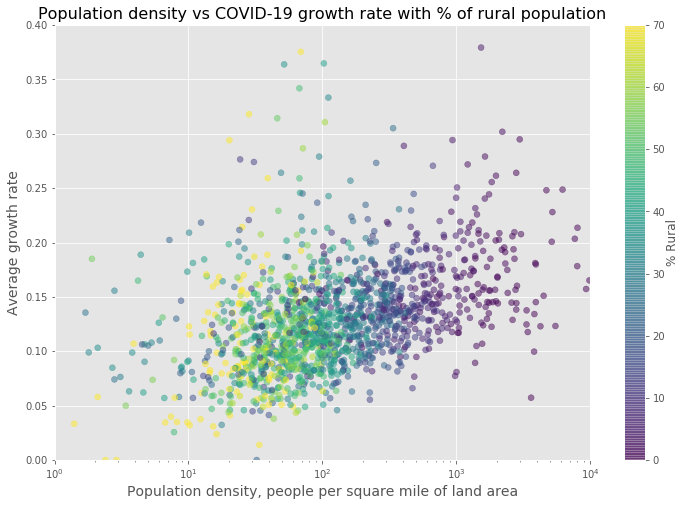

In [243]:
plt.figure(figsize=(12, 8))
plt.scatter(counties_merged['Density'], counties_merged['RateCases'], c=0.7*counties_merged['% Rural'], alpha=0.5)
cbar= plt.colorbar()
cbar.set_label("% Rural", labelpad=+1)

plt.xlabel("Population density, people per square mile of land area", size=14)
plt.xlim(1,10000)
plt.xscale('log')
plt.ylabel("Average growth rate", size=14)
plt.ylim(0, 0.4)
plt.title("Population density vs COVID-19 growth rate with % of rural population", size=16)

plt.show
plt.savefig('Figures/Density_vs_Growth Rate')